# Keras Model NNs for Classification
#### April 20, 2018

## Libraries and Helper Functions

In [1]:
import tensorflow
import keras
import gensim
import lime
import pandas as pd
import numpy as np
import re
import itertools
import math

# Import helper functions that we wrote
#import w266_final_project_helper_functions as hf

# Numpy shorthand stuff
from numpy import array

# Keras shorthand stuff
from keras.preprocessing.text import one_hot
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Conv1D, MaxPooling1D , Dense, Dropout, Activation, LSTM
from keras.layers.embeddings import Embedding
from keras.layers.core import Flatten
from keras.models import Sequential
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint
from keras.utils import to_categorical

# Lime shorthand stuff
from lime import lime_text
from lime.lime_text import LimeTextExplainer

# NLTK shorthand stuff
from nltk.tokenize import TweetTokenizer
from nltk.stem import PorterStemmer

# SK-learn libraries
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.linear_model import SGDClassifier
from sklearn.feature_extraction.text import *
from sklearn.pipeline import make_pipeline

%matplotlib inline

/Users/chadharness/anaconda/envs/py36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [270]:
# Borrowed some functions from the w266 utils.py file
# Miscellaneous helpers
def flatten(list_of_lists):
    """Flatten a list-of-lists into a single list."""
    return list(itertools.chain.from_iterable(list_of_lists))


# Word processing functions
def canonicalize_digits(word):
    if any([c.isalpha() for c in word]): return word
    word = re.sub("\d", "DG", word)
    if word.startswith("DG"):
        word = word.replace(",", "") # remove thousands separator
    return word


# Made some modifications of our own here
def canonicalize_word(word, wordset=None, digits=True):
    #replace hyperlinks with one instance of "postedhyperlinkvalue"
    word = re.sub(r"(https?:\/\/)?([\da-z\.-]+)\.([a-z\.]{2,6})([\/\w\.-]*)*\/?\S*", "postedhyperlinkvalue", word)
    word = re.sub(r"(postedhyperlinkvalue)+", "postedhyperlinkvalue", word)
    #only lower case words (2 letters or longer) that are not all upper case
    if not word.isupper() or len(word) == 1:
        word = word.lower()
    #replace things like haha with ha
    word = re.sub(r"([a-z]{2,})\1{2,}", r"\1", word)
    #replace any three consecutive, identical letters with two instances of that letter
    word = re.sub(r"([a-z])\1{2,}", r"\1\1", word)
    #creplace any two consecutive, identical consonants at the beginning of a string with one of that consonant
    word = re.sub(r"(^[^aeiou])\1{1,}", r"\1", word)
    
    #replace digits with a stand-in token
    if digits:
        if (wordset != None) and (word in wordset): return word
        word = canonicalize_digits(word) # try to canonicalize numbers
    if (wordset == None) or (word in wordset):
        return word
    else:
        return constants.UNK_TOKEN

    
def canonicalize_words(words, **kw):
    return [canonicalize_word(word, **kw) for word in words]


## Made some helper functions of our own --------------------------------------------------------##
def stem_sentence(token_sent, stemmer=PorterStemmer()):
    stem_token_sent = []
    for word in token_sent:
        stem_token_sent.append(stemmer.stem(word))
    
    return stem_token_sent   


def make_data(data, target, tokenizer=TweetTokenizer(), canonize=True, stem=True):      
    # Separate comments
    comments = data.loc[:, 'comment_body']
    labels = data.loc[:, target]
    
    # Convert to list
    comment_list = comments.values.tolist()
    
    # Tokenize comments
    tokenizer = tokenizer
    # A list of lists of tokenized sentences: word == string/token; sentence == list of string/tokens
    tokenized_sentences = [tokenizer.tokenize(sentence) for sentence in comment_list]
    
    if stem:
        # Stem words
        comments_stem = []
        for sentence in tokenized_sentences:
            x_tokens_stem = stem_sentence(token_sent=sentence, stemmer=PorterStemmer())
            comments_stem.append(x_tokens_stem)
        tokenized_sentences = comments_stem
    
    if canonize:
        # Canonize words
        comments_canon = []
        for sentence in tokenized_sentences:
            x_tokens_canon = canonicalize_words(sentence)
            comments_canon.append(x_tokens_canon)
        # A list of lists of scrubbed tokens; token == word, list == sentence
        tokenized_sentences = comments_canon
    
    x_tokens = tokenized_sentences  
    
    return comments, x_tokens, labels


def rawlist_to_xtokens(rawlist=['default arg'], vocab=[]):
    '''
    Inputs:
        rawlist == list of strings with each string representing a comment
        vocab == iterable containing words as strings that are part of an allowable corpora vocabulary
    Outputs:
        xtokens == list of word tokens (strings)    
    Purpose:
        Take a list of comments (strings) and an iterable of allowable vocab words (strings) 
        as inputs and output list of lists of words that are also found in vocab. Each inner 
        list of the output represents a comment. Each word in an inner list is a tokenized string.
    '''
    xtokens = []
    for rawstring in rawlist:
        xtoken = list(filter(lambda x: x in vocab, rawstring.split()))
        xtokens.append(xtoken)   
    
    return xtokens

'''
def rawlist_to_xtokens(rawlist=['default arg']):
    xtokens = []
    for rawstring in rawlist:
        #print(rawstring)
        xtoken = list(filter(lambda x: x in model_nsg_pp2.wv.vocab, rawstring.split()))
        #print(xtoken)
        xtokens.append(xtoken)
        
    return xtokens
'''

def xtoken_to_raw(xtoken=['default','arg']):
    '''
    Inputs:
        xtoken == list of tokenized strings representing order-preserved words in a comment  
    Outputs:
        raw_text_string == a string that contains all words in xtoken, separated by a space
    Purpose:
        Take a list of tokenized strings as input and output a string that represents a comment
    '''
    raw_text_string = ' '.join(xtoken)
    
    return raw_text_string


def raw_to_xtoken(raw_string='default arg'):
    '''
    Inputs:
        raw_string == a string that represents a comment   
    Outputs:
        xtoken == list of tokenized strings representing order-preserved words in a comment
    Purpose:
        Take a string that represents a comment as input and output a list of tokenized words (strings)
    '''
    xtoken = raw_string.split()
    
    return xtoken


#def predict_proba_string(list_d_strings=['default arg', 'default arg'], vocab=[], 
#                         pad_func=lambda idx:idx, model=Sequential()):
#    '''
#    Inputs:
#        list_d_strings == list of strings with each string representing a comment
#        vocab == iterable containing words as strings that are part of an allowable corpora vocabulary
#        pad_func == function that will take as an argument a list of lists of integers and add zeroes 
#                    to the end of each list
#        model == a Keras Sequential() class model that expects an numpy array of fixed length lists of integers 
#                    as inputs and returns a numpy array of class probabilities (like predict_proba from sklearn)
#        
#    Outputs:
#        preds == a numpy array of class probabilities (like predict_proba from sklearn)
#    
#    Purpose:
#        Take a list of comments (strings), an iterable of allowable vocab words (strings),
#       a function that add zeroes to the end of each list in a list of lists, and a Keras Sequential() model
#        as inputs and output a numpy array of class probabilities
#    '''
#        
#    x_tokens = rawlist_to_xtokens(list_d_strings)
#    #padded_doc_w2v = [[vocab[word].index for word in sentence] for sentence in x_tokens]
#    padded_doc_w2v = [[embeddings.wv.vocab[word].index for word in sentence] for sentence in x_tokens]
#    padded_docs = pad_func(padded_doc_w2v, maxlen=100, padding='post')
#    preds = model.predict(padded_docs)
#    
#    return preds

'''
def compile_pps(model, vocab):

    This function is a wrapper that allows us to return predict_proba_string with a new model for LIME 
    to approximate.

    def predict_proba_string(list_d_strings):
    
    
       #This function mimics the behavior that LIME expects form a scikitlearn classifier
    
        #print(list_d_strings)
        #dummy_list = [list_d_strings, ['the', 'touchdown']]
        x_tokens = rawlist_to_xtokens(list_d_strings)
        #padded_doc_w2v = [[embeddings.wv.vocab[word].index for word in sentence] for sentence in x_tokens]
        padded_doc_w2v = [[vocab[word].index for word in sentence] for sentence in x_tokens]
        padded_docs = pad_sequences(padded_doc_w2v, maxlen=100, padding='post')
        return model.predict(padded_docs)
    
    return predict_proba_string
'''

def get_top_logreg_feats(feat_coefs, xtokens):
    top_feats = [[(word, feat_coefs.get(word, 0.0)) for word in sentence] for sentence in xtokens]
    top_feats = pd.Series(dict(itertools.chain.from_iterable(top_feats)))
    top_feats = top_feats[top_feats != 0].sort_values(ascending=False)
    #top_feats = top_feats.sort_values(ascending=False)
    
    return top_feats

'''
def get_lime_explanation(df=None, model=None, nn=0, explainer=None, vocab=None):
    test_comment = comments[df.name]
    token_list = x_tokens[df.name]
    num_features = min(15, len(token_list))
    if nn:
        #predict_proba_string = compile_pps(model=lstm)
        predict_func = compile_pps(model=model, vocab=vocab)
    
    else:
        predict_func = model
    #explainer = LimeTextExplainer(class_names=class_names)
    #exp = explainer.explain_instance(test_comment, predict_proba_string, num_features=num_features)
    
    exp = explainer.explain_instance(test_comment, predict_func, num_features=num_features)
    
    return exp
'''

def define_model(model_type=None, dropout=0.5, vocab_size=0, vector_dim=100, 
                 weights=[], input_length=100, trainable=False, num_filters=5):
    
    if model_type == None:
        print("You must select a model type. Valid arguments are 'cnn' or 'lstm'.")
        return
    
    model = Sequential()
    
    if len(weights) > 0:
        model.add(Embedding(vocab_size, vector_dim, weights=weights, input_length=input_length, 
                            trainable=trainable))
    else:
        model.add(Embedding(vocab_size, vector_dim, input_length=input_length, trainable=trainable))
    
    if model_type == 'cnn':
        model.add(Conv1D(num_filters,1,activation='tanh'))
        model.add(MaxPooling1D(pool_size=(3,),strides=1))
        model.add(Dropout(dropout))
        model.add(Conv1D(num_filters*2,2,activation='relu'))
        model.add(MaxPooling1D(pool_size=(2,),strides=1))
        model.add(Dropout(dropout))
        model.add(Flatten())
        model.add(Dense(256,activation='tanh'))
        model.add(Dropout(dropout))
        model.add(Dense(128,activation='tanh'))
        model.add(Dense(2,activation='softmax'))
            
    if model_type == 'lstm':
        kernel_initializer=keras.initializers.RandomUniform(minval=-1, maxval=1, seed=None)
        recurrent_initializer=keras.initializers.Zeros()
        model.add(LSTM(units=100, dropout=dropout, kernel_initializer=kernel_initializer, 
                       recurrent_initializer=recurrent_initializer))
        model.add(Dense(2,activation='sigmoid'))
    
    return model


def model_diagnostics(model, data, labels, target_names, random=False, test_size=0.10, random_state=42):
    
    # Split into test and train
    # Designate random test_size% of data (rounded up to next obs) as test data
    if random:
        train_data, test_data, train_labels, test_labels = train_test_split(data, labels, 
                                                                            test_size=test_size, 
                                                                            random_state=random_state)
    # Designate last test_size% of data (rounded up to next obs) as test data 
    else:
        idx = round(test_size*len(data))
        test_data = data[-idx:]
        test_labels = labels[-idx:]
    
    
    pred_labels = model.predict_classes(test_data)
    
    print("Test data length is: ", len(test_data))
    print("Test label length is: ", len(test_labels))
    print("Pred label length is: ", len(pred_labels))
    
    confusionMatrix = metrics.confusion_matrix(test_labels, pred_labels)
    classificationReport = classification_report(test_labels, pred_labels, target_names=target_names)
    
    return confusionMatrix, classificationReport

## Data Preprocessing
### Loading and Cleaning

In [3]:
data = pd.read_csv('../../../Comments_FanofGame_data_bandwagon.csv')
data.shape

(2018028, 7)

In [4]:
data.head()

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon
0,0,Bengals,Game Thread: Detroit Lions (8-6) at Cincinnati...,I love Lions fans cause we can drink bleach to...,1,0,1
1,1,Lions,Game Thread: Detroit Lions (8-6) at Cincinnati...,"I was back and forth with this, but I'm on the...",1,0,1
2,2,Lions,Game Thread: Detroit Lions (8-6) at Cincinnati...,Ebron with that sick Naruto run.,1,0,1
3,3,Lions,Game Thread: Detroit Lions (8-6) at Cincinnati...,"""Here, Merry Christmas. have this win.""\n\n""No...",1,0,1
4,4,Eagles - Bandwagon,Game Thread: Detroit Lions (8-6) at Cincinnati...,The coaching staff does realize that if we los...,0,1,0


In [4]:
# Remove problematic comments
data = data[data.comment_body.notnull()]
data = data[data.comment_body != "no value"]
data = data[data.comment_body!='[removed]']
data = data[data.comment_body!='[deleted]']
data = data[~data.comment_body.str.contains("\^This \^message \^was \^created \^by \^a \^bot")]
data = data[~data.comment_body.str.contains("\*\*Please review the rules for")]
data = data[data.notnull()]

# Remove Superbowl and playoff Threads
data = data[
(data.submission_title!='Super Bowl LII Game Thread: Philadelphia Eagles (15-3) at New England Patriots (15-3)') &
(data.submission_title!='Super Bowl LII Game Thread: Philadelphia Eagles (15-3) at New England Patriots (15-3) (Second Half)') &
(data.submission_title!='Super Bowl 51 Pre Game Thread: New England Patriots (14-2) at Atlanta Falcons (11-5)') &
(data.submission_title!='Super Bowl 51 Post Game Thread: New England Patriots (14-2) at Atlanta Falcons (11-5)') &
(data.submission_title!='Game Thread: Atlanta Falcons (10-6) at Los Angeles Rams (11-5)') &
(data.submission_title!='Game Thread: Tennessee Titans (9-7) at Kansas City Chiefs (10-6)') &
(data.submission_title!='Game Thread: Buffalo Bills (9-7) at Jacksonville Jaguars (10-6)') &
(data.submission_title!='Game Thread: Carolina Panthers (11-5) at New Orleans Saints (11-5)') &
(data.submission_title!='Game Thread: Atlanta Falcons (11-6) at Philadelphia Eagles (13-3)') &
(data.submission_title!='Game Thread: Tennessee Titans (10-7) at New England Patriots (13-3)') &
(data.submission_title!='Game Thread: Jacksonville Jaguars (11-6) at Pittsburgh Steelers (13-3)') &
(data.submission_title!='Game Thread: Jacksonville Jaguars (12-6) at New England Patriots (14-3)') &
(data.submission_title!='Game Thread: Minnesota Vikings (14-3) at Philadelphia Eagles (14-3)')]

data.count()

Unnamed: 0                         1542039
author_flair                       1542039
submission_title                   1542039
comment_body                       1542039
fan_of_team_playing                1542039
bandwagon                          1542039
fan_of_team_playing_w_bandwagon    1542039
dtype: int64

In [5]:
# Perform all desired pre-processing and split data into 
# panda series of raw comments, 
# list of list of tokens, and 
# panda series of target labels
comments, x_tokens, labels = make_data(data, target='fan_of_team_playing', canonize=True, stem=False)

### Word Embeddings

In [9]:
# Define length of word vector
vector_dim = 100

In [134]:
# Build word2vec embeddings model (skip-gram w/negative sampling)
model_nsg_pp2 = gensim.models.Word2Vec(sentences=x_tokens, sg=1, size=vector_dim, hs=0, negative=12, 
                                       workers=8, compute_loss=True, max_vocab_size=None, min_count=0)
# Save model
model_nsg_pp2.save('model_nsg_pp2.bin')

In [6]:
# Load model:
embeddings = gensim.models.Word2Vec.load('model_nsg_pp2.bin')
print(embeddings)

Word2Vec(vocab=134884, size=100, alpha=0.025)


In [7]:
# Define the vocab size as a parameter to be reused
vocab_size = len(embeddings.wv.vocab)

### Transform Data

In [10]:
# Define maximum length of each comment
max_length = 100

# Transform features into appropriate formats
padded_docs_w2v = [[embeddings.wv.vocab[word].index for word in sentence] for sentence in x_tokens]
padded_docs = pad_sequences(padded_docs_w2v, maxlen=max_length, padding='post')

# Convert the word embeddings into a numpy array that is suitable for Keras
embedding_matrix = np.zeros((len(embeddings.wv.vocab), vector_dim))
for i in range(len(embeddings.wv.vocab)):
    embedding_vector = embeddings.wv[embeddings.wv.index2word[i]]
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

# Convert labels to categorical variables for Keras
y_binary = to_categorical(labels)

In [350]:
type(padded_docs)

numpy.ndarray

In [351]:
padded_docs.shape

(1542039, 100)

## Create Models

### CNN

In [15]:
# Define CNN
cnn = define_model(model_type='cnn', 
                   dropout=0.5, 
                   vocab_size=vocab_size, 
                   vector_dim=vector_dim, 
                   weights=[embedding_matrix], 
                   input_length=max_length, 
                   trainable=False, 
                   num_filters=5)

cnn.compile(loss='binary_crossentropy', 
            optimizer=Adam(lr=0.0001, decay=1e-5), 
            metrics=['mse', 'acc'])

print(cnn.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 100, 100)          13488400  
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 100, 5)            505       
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 98, 5)             0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 98, 5)             0         
_________________________________________________________________
conv1d_2 (Conv1D)            (None, 97, 10)            110       
_________________________________________________________________
max_pooling1d_2 (MaxPooling1 (None, 96, 10)            0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 96, 10)            0         
__________

#### Save parameters

In [16]:
# Checkpoint for periodically saving model
filepath="weights-improvement-april20-cnn-pp-{epoch:02d}-{val_acc:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_acc', verbose=1, save_best_only=False, mode='max')
callbacks_list = [checkpoint]

#### Initial model training

In [17]:
# !!!!!!!!!CHECK SAVE PARAMETERS ABOVE!!!!!!!!!!
cnn.fit(padded_docs, y_binary, epochs=1, verbose=1, validation_split=0.10, callbacks=callbacks_list)

Train on 1387835 samples, validate on 154204 samples
Epoch 1/1
1387835/1387835 [==============================] - 429s 309us/step - loss: 0.6854 - mean_squared_error: 0.2462 - acc: 0.5489 - val_loss: 0.6751 - val_mean_squared_error: 0.2412 - val_acc: 0.5747

Epoch 00001: saving model to weights-improvement-april20-cnn-pp-01-0.57.hdf5


#### Load model

In [19]:
# Load model from file

# Best epoch/file: "weights-improvement-april15-april19-cnn-pp-17-0.59.hdf5"
# Best train accuracy: 0.5895
# Note: model peformance might have slightly increased with additional training but i ran out of time

cnn = keras.models.load_model("weights-improvement-april15-april19-cnn-pp-17-0.59.hdf5")

#### Subsequent model training

In [18]:
# !!!!!!!!!CHECK MODEL SAVE PARAMETERS ABOVE!!!!!!!!!!
# Compile model
cnn.compile(loss='binary_crossentropy', 
            optimizer=Adam(lr=0.0001, decay=1e-5), 
            metrics=['mse', 'acc'])

# Fit model
cnn.fit(padded_docs, y_binary, initial_epoch=1, epochs=2, 
        verbose=1, validation_split=0.10, callbacks=callbacks_list)

Train on 1387835 samples, validate on 154204 samples
Epoch 2/2
1387835/1387835 [==============================] - 410s 295us/step - loss: 0.6746 - mean_squared_error: 0.2410 - acc: 0.5723 - val_loss: 0.6694 - val_mean_squared_error: 0.2385 - val_acc: 0.5837

Epoch 00002: saving model to weights-improvement-april20-cnn-pp-02-0.58.hdf5


### LSTM

In [31]:
# Define LSTM
lstm = define_model(model_type='lstm', 
                   dropout=0.2, 
                   vocab_size=vocab_size, 
                   vector_dim=vector_dim, 
                   weights=[embedding_matrix], 
                   input_length=max_length, 
                   trainable=False)

lstm.compile(loss='binary_crossentropy', 
            optimizer=Adam(lr=0.0001, decay=1e-5), 
            metrics=['mse', 'acc'])

print(lstm.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 100, 100)          13488400  
_________________________________________________________________
lstm_1 (LSTM)                (None, 100)               80400     
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 202       
Total params: 13,569,002
Trainable params: 80,602
Non-trainable params: 13,488,400
_________________________________________________________________
None


#### Save parameters

In [32]:
# Checkpoint for periodically saving model
filepath="weights-improvement-april18-lstm-pp-{epoch:02d}-{val_acc:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_acc', verbose=1, save_best_only=False, mode='max')
callbacks_list = [checkpoint]

#### Initial model training

In [963]:
# !!!!!!!!!CHECK SAVE PARAMETERS ABOVE!!!!!!!!!!
lstm.fit(padded_docs, y_binary, epochs=5, verbose=1, validation_split=0.10, callbacks=callbacks_list)

Train on 1387835 samples, validate on 154204 samples
Epoch 1/5
1387835/1387835 [==============================] - 3707s 3ms/step - loss: 0.6927 - mean_squared_error: 0.2498 - acc: 0.5232 - val_loss: 0.6886 - val_mean_squared_error: 0.2477 - val_acc: 0.5369

Epoch 00001: saving model to weights-improvement-april18-lstm-01-0.54.hdf5
Epoch 2/5
1387835/1387835 [==============================] - 3658s 3ms/step - loss: 0.6867 - mean_squared_error: 0.2468 - acc: 0.5457 - val_loss: 0.6806 - val_mean_squared_error: 0.2438 - val_acc: 0.5646

Epoch 00002: saving model to weights-improvement-april18-lstm-02-0.56.hdf5
Epoch 3/5
1387835/1387835 [==============================] - 3667s 3ms/step - loss: 0.6815 - mean_squared_error: 0.2443 - acc: 0.5622 - val_loss: 0.6765 - val_mean_squared_error: 0.2418 - val_acc: 0.5718

Epoch 00003: saving model to weights-improvement-april18-lstm-03-0.57.hdf5
Epoch 4/5
1387835/1387835 [==============================] - 3717s 3ms/step - loss: 0.6785 - mean_squared_e

#### Load model

In [33]:
# Load model from file

# Best epoch/file: "weights-improvement-april15-lstm-11-0.59.hdf5"
# Best train accuracy: 0.5907
# Note: model peformance might have slightly increased with additional training but i ran out of time

lstm = keras.models.load_model("weights-improvement-april15-lstm-11-0.59.hdf5")

#### Subsequent model training

In [18]:
# !!!!!!!!!CHECK MODEL SAVE PARAMETERS ABOVE!!!!!!!!!!
# Compile model
lstm.compile(loss='binary_crossentropy', 
            optimizer=Adam(lr=0.0001, decay=1e-5), 
            metrics=['mse', 'acc'])

# Fit model
lstm.fit(padded_docs, y_binary, initial_epoch=11, epochs=12, 
        verbose=1, validation_split=0.10, callbacks=callbacks_list)

Train on 1387835 samples, validate on 154204 samples
Epoch 2/2
1387835/1387835 [==============================] - 410s 295us/step - loss: 0.6746 - mean_squared_error: 0.2410 - acc: 0.5723 - val_loss: 0.6694 - val_mean_squared_error: 0.2385 - val_acc: 0.5837

Epoch 00002: saving model to weights-improvement-april20-cnn-pp-02-0.58.hdf5


## Model Diagnostics

In [20]:
# Define meaningful labels for target categories
target_names = ['casual observer', 'fan']

### Best performing CNN (train/test randomized 90/10)

In [75]:
#"weights-improvement-april18b-cnn-pp-09-0.58.hdf5" <- best performing CNN trained on train/test randomized 90/10
# model peformance declined after epoch 9
# Load best CNN (train/test randomized 90/10)
# train accuracy = 0.5819
model = keras.models.load_model("weights-improvement-april18b-cnn-pp-09-0.58.hdf5")

#### scored vs. randomly selected 10% of data

In [59]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=True, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)
#        |      predicted
#actual |----------------
#--------|not fan | fan
#not fan
#fan

# Overall accuracy = 0.5819

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[28099 44951]
 [19525 61629]]
                 precision    recall  f1-score   support

casual observer       0.59      0.38      0.47     73050
            fan       0.58      0.76      0.66     81154

    avg / total       0.58      0.58      0.57    154204



#### scored vs. last 10% of data

In [76]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=False, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)

# 90,640 correctly predicted
# Overall accuracy = 0.5878 --> (better) predicted fewer/more fans/casual more/same precision less/more recall

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[28587 43300]
 [20264 62053]]
                 precision    recall  f1-score   support

casual observer       0.59      0.40      0.47     71887
            fan       0.59      0.75      0.66     82317

    avg / total       0.59      0.59      0.57    154204



### Best performing CNN (train/test first/last 90/10)

In [70]:
#"weights-improvement-april15-april19-cnn-pp-17-0.59.hdf5" <- best CNN trained on default Sequential() holdout
# model peformance might have slightly increased with additional training but i ran out of time
# Load best CNN (train/test randomized 90/10)
# train accuracy = 0.5895
model = keras.models.load_model("weights-improvement-april15-april19-cnn-pp-17-0.59.hdf5")

#### scored vs. randomly selected 10% of data

In [71]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=True, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)

# 90,647 correctly predicted but casual/fan mix way more casual than vs. rando trained CNNjk
# Overall accuracy = 0.5878

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[35170 37880]
 [25677 55477]]
                 precision    recall  f1-score   support

casual observer       0.58      0.48      0.53     73050
            fan       0.59      0.68      0.64     81154

    avg / total       0.59      0.59      0.58    154204



#### scored vs. last 10% of data

In [62]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=False, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)

# Overall accuracy = 0.5895 --> (better) predicted fewer/more fans/casual more/less precision same/more recall

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[35154 36733]
 [26566 55751]]
                 precision    recall  f1-score   support

casual observer       0.57      0.49      0.53     71887
            fan       0.60      0.68      0.64     82317

    avg / total       0.59      0.59      0.59    154204



### Best performing LSTM (train/test randomized 90/10)

In [65]:
#weights-improvement-april18-lstm-05-0.58.hdf5 <- best performing LSTM trained on randomized holdout
# Load best LSTM
# test accuracy = 0.5718 (4/18 #3)
# test accuracy = 0.5774 (4/18 #4)
# test accuracy = 0.5792 (4/18 #5)
# model performance might have improved but i ran out of time
model = keras.models.load_model("weights-improvement-april18-lstm-05-0.58.hdf5")

#### scored vs. randomly selected 10% of data

In [67]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=True, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)

# Overall accuracy = 0.5792

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[39298 33752]
 [31127 50027]]
                 precision    recall  f1-score   support

casual observer       0.56      0.54      0.55     73050
            fan       0.60      0.62      0.61     81154

    avg / total       0.58      0.58      0.58    154204



#### scored vs. last 10% of data

In [66]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=False, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)

# Overall accuracy = 0.5825 --> (better) predicted fewer/more fans/casual more/less precision same/same recall

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[38999 32888]
 [31491 50826]]
                 precision    recall  f1-score   support

casual observer       0.55      0.54      0.55     71887
            fan       0.61      0.62      0.61     82317

    avg / total       0.58      0.58      0.58    154204



### Best performing LSTM (train/test first/last 90/10)

In [72]:
#weights-improvement-april15-lstm-11-0.59.hdf5 <- best performing LSTM trained on default holdout for Sequential
# Load best LSTM
# test accuracy = 0.5888 (4/15 #9)
# test accuracy = 0.5891 (4/15 #10)
# test accuracy = 0.5907 (4/15 #11)
# model performance might have improved but i ran out of time
model = keras.models.load_model("weights-improvement-april15-lstm-11-0.59.hdf5")

#### scored vs. randomly selected 10% of data

In [73]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=True, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)

# Overall accuracy = 0.5905

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[38127 34923]
 [28220 52934]]
                 precision    recall  f1-score   support

casual observer       0.57      0.52      0.55     73050
            fan       0.60      0.65      0.63     81154

    avg / total       0.59      0.59      0.59    154204



#### scored vs. last 10% of data

In [64]:
confusionMatrix, classificationReport = model_diagnostics(model=model, data=padded_docs, 
                                                          labels=labels, target_names=target_names, 
                                                          random=False, test_size=0.10, random_state=42)
print("Confusion Matrix...")
print("predict/actual, casual observer/fan")
print(confusionMatrix)
print(classificationReport)

# Overall accuracy = 0.5907 --> (sl. better) predicted fewer/more fans/casual more/same precision same/more recall 

Test data length is:  154204
Test label length is:  154204
Pred label length is:  154204
Confusion Matrix...
predict/actual, casual observer/fan
[[37752 34135]
 [28971 53346]]
                 precision    recall  f1-score   support

casual observer       0.57      0.53      0.54     71887
            fan       0.61      0.65      0.63     82317

    avg / total       0.59      0.59      0.59    154204




## Linguistic Analysis via Comparative Model Behaviors 

### Generate predictions for models

For the neural networks, we will focus on the CNN and LSTM that were trained and validated against the Keras Sequential() class default first/last split, which we set at 90/10. For the linear model, we will focus on the logistic regression with L1 penalty.

#### Load models

In [11]:
# Both models were trained using Keras' Sequential() default first/last split, which we set at 90/10
lstm = keras.models.load_model("weights-improvement-april15-lstm-11-0.59.hdf5")
cnn = keras.models.load_model("weights-improvement-april15-april19-cnn-pp-17-0.59.hdf5")

In [247]:
# Fit logistic regression with L1 penalty
train_data = x_tokens[ : 1387835]
train_labels = labels[ : 1387835]
test_data = x_tokens[1387835 : ]
test_labels = labels[1387835 : ]

vectorizer = TfidfVectorizer(analyzer='word', lowercase=False, stop_words = 'english', tokenizer=lambda text: text)

train_data_sparse = vectorizer.fit_transform(train_data)

lgstl1 = SGDClassifier(loss="log", penalty="l1", random_state=42)
lgstl1.fit(train_data_sparse, train_labels)

/Users/chadharness/anaconda/envs/py36/lib/python3.6/site-packages/sklearn/linear_model/stochastic_gradient.py:128: FutureWarning: max_iter and tol parameters have been added in <class 'sklearn.linear_model.stochastic_gradient.SGDClassifier'> in 0.19. If both are left unset, they default to max_iter=5 and tol=None. If tol is not None, max_iter defaults to max_iter=1000. From 0.21, default max_iter will be 1000, and default tol will be 1e-3.
  "and default tol will be 1e-3." % type(self), FutureWarning)


SGDClassifier(alpha=0.0001, average=False, class_weight=None, epsilon=0.1,
       eta0=0.0, fit_intercept=True, l1_ratio=0.15,
       learning_rate='optimal', loss='log', max_iter=None, n_iter=None,
       n_jobs=1, penalty='l1', power_t=0.5, random_state=42, shuffle=True,
       tol=None, verbose=0, warm_start=False)

#### Generate predictions

In [249]:
# Transform full data set to generate predictions using logistic regression with L1 penalty
data_sparse = vectorizer.transform(x_tokens)
lgstl1_pred_probs = lgstl1.predict_proba(data_sparse)

In [14]:
# Generate class probability predictions over the entire data set
lstm_pred_probs = lstm.predict(padded_docs)
cnn_pred_probs = cnn.predict(padded_docs)
lgstl1_pred_probs = lgstl1.predict_proba(data_sparse)

In [355]:
we_lang1 = ['we', 'our', 'we', 'we']
we_lang2 = ['our', 'we', 'our', 'we']
we_lang3 = ['we', 'watch', 'with', 'each', 'other']
we_x_tokens =[we_lang1, we_lang2, we_lang3]

padded_we_w2v = [[embeddings.wv.vocab[word].index for word in sentence] for sentence in we_x_tokens]
padded_we = pad_sequences(padded_docs_w2v, maxlen=max_length, padding='post')

lstm.predict(padded_we)

array([[0.5329263 , 0.46944928],
       [0.27109852, 0.72723705],
       [0.36321008, 0.63782144],
       ...,
       [0.5248761 , 0.4773067 ],
       [0.42641968, 0.5747867 ],
       [0.49377802, 0.5081357 ]], dtype=float32)

In [356]:
len(padded_we_w2v)

3

In [357]:
type(padded_we_w2v)

list

In [358]:
padded_we_w2v

[[22, 68, 22, 22], [68, 22, 68, 22], [22, 185, 33, 690, 192]]

In [359]:
len(padded_we)

1542039

In [360]:
type(padded_we)

numpy.ndarray

In [358]:
padded_we_w2v

[[22, 68, 22, 22], [68, 22, 68, 22], [22, 185, 33, 690, 192]]

In [352]:
type(x_tokens)

list

In [353]:
len(x_tokens)

1542039

In [354]:
x_tokens[:3]

[['i',
  'love',
  'lions',
  'fans',
  'cause',
  'we',
  'can',
  'drink',
  'bleach',
  'together',
  'this',
  'christmas',
  'eve'],
 ['i',
  'was',
  'back',
  'and',
  'forth',
  'with',
  'this',
  ',',
  'but',
  "i'm",
  'on',
  'the',
  'fire',
  'caldwell',
  'train',
  'now',
  '.',
  'this',
  'is',
  'embarrassing',
  '.'],
 ['ebron', 'with', 'that', 'sick', 'naruto', 'run', '.']]

In [251]:
# Create arrays that contain prediction probabilities
lstm_prob_casual = lstm_pred_probs[:,0]
lstm_prob_fan = lstm_pred_probs[:,1]
cnn_prob_casual = cnn_pred_probs[:,0]
cnn_prob_fan = cnn_pred_probs[:,1]
lgst_prob_casual = lgstl1_pred_probs[:,0]
lgst_prob_fan = lgstl1_pred_probs[:,1]

# Create arrays that contain binary predictions (1=fan, 0=casual)
#data_w_preds['pred_fan'] = np.where(data_w_preds['prob_fan'] > data_w_preds['prob_notfan'], 1, 0)
lstm_pred_fan = np.where(lstm_prob_fan > lstm_prob_casual, 1, 0)
cnn_pred_fan = np.where(cnn_prob_fan > cnn_prob_casual, 1, 0)
lgst_pred_fan = np.where(lgst_prob_fan > lgst_prob_casual, 1, 0)

# Create arrays that contain differences in prediction probabilities between classes within a given model
#data_w_preds['prob_off'] = np.where(data_w_preds['pred_fan'] == data_w_preds['fan_of_team_playing_w_bandwagon'], 
#                                    0.0, abs(data_w_preds['prob_fan'] - data_w_preds['prob_notfan']))
lstm_prob_diff = abs(lstm_prob_fan - lstm_prob_casual)
cnn_prob_diff = abs(cnn_prob_fan - cnn_prob_casual)
lgst_prob_diff = abs(lgst_prob_fan - lgst_prob_casual)

# Create arrays that contain differences in prediction probabilities between models within a given class
# Restrict to lstm v. cnn and lstm v. lgst
casual_prob_diff_lscn = abs(lstm_prob_casual - cnn_prob_casual)
fan_prob_diff_lscn = abs(lstm_prob_fan - cnn_prob_fan)
casual_prob_diff_lslg = abs(lstm_prob_casual - lgst_prob_casual)
fan_prob_diff_lslg = abs(lstm_prob_fan - lgst_prob_fan)

#### Create new dataframe that includes columns with prediction attributes under each model

In [252]:
preds_df = pd.DataFrame({'lstm_prob_casual': lstm_prob_casual, 'lstm_prob_fan': lstm_prob_fan, 
                         'lstm_pred_fan': lstm_pred_fan,
                         'lstm_prob_diff': lstm_prob_diff,
                         'cnn_prob_casual': cnn_prob_casual, 'cnn_prob_fan': cnn_prob_fan,
                         'cnn_pred_fan': cnn_pred_fan,
                         'cnn_prob_diff': cnn_prob_diff,
                         'lgst_prob_casual': lgst_prob_casual, 'lgst_prob_fan': lgst_prob_fan,
                         'lgst_pred_fan': lgst_pred_fan,
                         'lgst_prob_diff': lgst_prob_diff,
                         'casual_prob_diff_lscn': casual_prob_diff_lscn,
                         'fan_prob_diff_lscn': fan_prob_diff_lscn,
                         'casual_prob_diff_lslg': casual_prob_diff_lslg,
                         'fan_prob_diff_lslg': fan_prob_diff_lslg,
                        })

In [253]:
# Check index values to ensure they align
data.index.equals(preds_df.index)

True

In [254]:
# Evaluate index differences. I suspect that the original dataframe just needs to be reindexed to account
# for observations that were removed during data cleaning
print(data.index.values[:10])
print(data.index.values[-10:])
print(preds_df.index.values[:10])
print(preds_df.index.values[-10:])
print(len(data))
print(len(preds_df))

[0 1 2 3 4 5 6 7 8 9]
[1542029 1542030 1542031 1542032 1542033 1542034 1542035 1542036 1542037
 1542038]
[0 1 2 3 4 5 6 7 8 9]
[1542029 1542030 1542031 1542032 1542033 1542034 1542035 1542036 1542037
 1542038]
1542039
1542039


Both data sets clearly have the same number of observations and are in natural order, i.e. indices are strictly increasing. It seems clear that the indexing is "off" in "data" because of the values removed during data cleaning. A simple reindexing of "data" will fix the issue.

In [19]:
# Reindex data frame to align with prediction indices
data.index = range(len(data))

# Check index values again to ensure they align
data.index.equals(preds_df.index)

True

In [255]:
# Repeat for comments
comments.index = range(len(comments))
comments.index.equals(preds_df.index)

True

In [256]:
# Perform concatenation
data_w_preds = pd.concat([data, preds_df], axis=1)

##### Examine and validate new dataframe

In [257]:
data_w_preds.count()

Unnamed: 0                         1542039
author_flair                       1542039
submission_title                   1542039
comment_body                       1542039
fan_of_team_playing                1542039
bandwagon                          1542039
fan_of_team_playing_w_bandwagon    1542039
casual_prob_diff_lscn              1542039
casual_prob_diff_lslg              1542039
cnn_pred_fan                       1542039
cnn_prob_casual                    1542039
cnn_prob_diff                      1542039
cnn_prob_fan                       1542039
fan_prob_diff_lscn                 1542039
fan_prob_diff_lslg                 1542039
lgst_pred_fan                      1542039
lgst_prob_casual                   1542039
lgst_prob_diff                     1542039
lgst_prob_fan                      1542039
lstm_pred_fan                      1542039
lstm_prob_casual                   1542039
lstm_prob_diff                     1542039
lstm_prob_fan                      1542039
dtype: int6

In [22]:
data_w_preds.head()

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,casual_prob_diff_lscn,casual_prob_diff_lslg,cnn_pred_fan,...,fan_prob_diff_lscn,fan_prob_diff_lslg,lgst_pred_fan,lgst_prob_casual,lgst_prob_diff,lgst_prob_fan,lstm_pred_fan,lstm_prob_casual,lstm_prob_diff,lstm_prob_fan
0,0,Bengals,Game Thread: Detroit Lions (8-6) at Cincinnati...,I love Lions fans cause we can drink bleach to...,1,0,1,0.162885,0.193303,1,...,0.160509,0.190927,1,0.339624,0.320753,0.660376,0,0.532926,0.063477,0.469449
1,1,Lions,Game Thread: Detroit Lions (8-6) at Cincinnati...,"I was back and forth with this, but I'm on the...",1,0,1,0.093863,0.216426,1,...,0.092199,0.214761,1,0.487524,0.024951,0.512476,1,0.271099,0.456139,0.727237
2,2,Lions,Game Thread: Detroit Lions (8-6) at Cincinnati...,Ebron with that sick Naruto run.,1,0,1,0.072480,0.087554,1,...,0.073512,0.088586,1,0.450764,0.098471,0.549236,1,0.363210,0.274611,0.637821
3,3,Lions,Game Thread: Detroit Lions (8-6) at Cincinnati...,"""Here, Merry Christmas. have this win.""\n\n""No...",1,0,1,0.016159,0.000701,0,...,0.014862,0.000597,0,0.587609,0.175219,0.412391,0,0.588310,0.175323,0.412987
4,4,Eagles - Bandwagon,Game Thread: Detroit Lions (8-6) at Cincinnati...,The coaching staff does realize that if we los...,0,1,0,0.072146,0.193188,1,...,0.070183,0.191225,1,0.361690,0.276619,0.638310,1,0.168503,0.661032,0.829535


In [23]:
data_w_preds.tail()

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,casual_prob_diff_lscn,casual_prob_diff_lslg,cnn_pred_fan,...,fan_prob_diff_lscn,fan_prob_diff_lslg,lgst_pred_fan,lgst_prob_casual,lgst_prob_diff,lgst_prob_fan,lstm_pred_fan,lstm_prob_casual,lstm_prob_diff,lstm_prob_fan
1542034,2018023,Bengals,Game Thread: Cleveland Browns (2-0) at Tampa B...,Only when someone trash talks back. I don't go...,0,0,0,0.043591,0.051170,0,...,0.044777,0.049983,1,0.458333,0.083333,0.541667,0,0.509503,0.017820,0.491683
1542035,2018024,Buccaneers,Game Thread: Cleveland Browns (2-0) at Tampa B...,"the argument isn't for schedule, as we played ...",1,0,1,0.039545,0.031617,1,...,0.000432,0.070730,1,0.221915,0.556170,0.778085,1,0.190298,0.658517,0.848815
1542036,2018025,Patriots,Game Thread: Cleveland Browns (2-0) at Tampa B...,it would actually be 4-0-16 since they'd have ...,0,0,0,0.033214,0.057268,0,...,0.035397,0.055085,1,0.467608,0.064784,0.532392,0,0.524876,0.047569,0.477307
1542037,2018026,Browns,Game Thread: Cleveland Browns (2-0) at Tampa B...,"Another punt, another flag. Just saying.",1,0,1,0.009501,0.029145,1,...,0.010707,0.030351,1,0.455565,0.088871,0.544435,1,0.426420,0.148367,0.574787
1542038,2018027,Browns,Game Thread: Cleveland Browns (2-0) at Tampa B...,"So a guy held unnecessarily on a non return, h...",1,0,1,0.051116,0.017832,1,...,0.049202,0.019745,0,0.511610,0.023220,0.488390,1,0.493778,0.014358,0.508136


### Analyze language through models

In [ ]:
# Useful features and structures from our embeddings
#embeddings.wv --> actual word vectors as gensim class models.keyedvectors
#embeddings.wv.vocab --> dictionary of word : word vectors (as models.keyedvectors.Vocab) of key, value pairs
#embeddings.wv.index2word[i] --> list containing corpura vocab words indexed 1-1 with word indexes in nn models

In [24]:
# Define meaningful labels for class categories
class_names = ['casual observer', 'fan']

#### A little bit of prep work

In [258]:
# Grab logistic regression L1 penalty coefficients and corresponding feature names for comparisions with NNs.
lgst_feat_coefs = pd.Series({feature:coef for feature, coef in zip(vectorizer.get_feature_names(), 
                                                                   lgstl1.coef_[0])})

# Make a pipeline to feed logistic regression into LIME
c = make_pipeline(vectorizer, lgstl1)

In [268]:
type(lgst_feat_coefs)

pandas.core.series.Series

#### Comparative model predictions by the numbers

In [259]:
# What does unanimity look like?
nobs = len(data)
n_cnn_lstm_lgst = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan == lgst_pred_fan), 1, 0))
print('CNN, LSTM and logistic agree {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_cnn_lstm_lgst, \
                                                                                        n_cnn_lstm_lgst/nobs))
nobs = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan == lgst_pred_fan), 1, 0))
# When all three methods agree, how often are they right?
n_cnn_lstm_lgst_ok = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan == lgst_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When CNN, LSTM and logistic agree, they are correct {0:6,d} times, or ~ {1:3.3f} of those observations and ~{2:3.3f} of all observations.'.format(n_cnn_lstm_lgst_ok, \
                                                                                        n_cnn_lstm_lgst_ok/nobs, n_cnn_lstm_lgst_ok/len(data)))
nobs = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan == lgst_pred_fan) & (lstm_pred_fan == 1), 1, 0))
# When all three methods agree about a fan, how often are they right?
n_cnn_lstm_lgst_fan = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan == lgst_pred_fan) & \
                                (lstm_pred_fan == 1) & (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('\nWhen CNN, LSTM and logistic agree about a fan, they are correct {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_cnn_lstm_lgst_fan, \
                                                                                        n_cnn_lstm_lgst_fan/nobs))
nobs = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan == lgst_pred_fan) & (lstm_pred_fan == 0), 1, 0))
# When all three methods agree about a casual observer, how often are they right?
n_cnn_lstm_lgst_co = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan == lgst_pred_fan) & \
                                (lstm_pred_fan == 0) & (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When CNN, LSTM and logistic agree about a casual observer, they are correct {0:6,d} times, or ~ {1:3.3f} of those obs.'.format(n_cnn_lstm_lgst_co, \
                                                                                        n_cnn_lstm_lgst_co/nobs))

CNN, LSTM and logistic agree 890,463 times, or ~ 0.577 of all observations.
When CNN, LSTM and logistic agree, they are correct 555,643 times, or ~ 0.624 of those observations and ~0.360 of all observations.

When CNN, LSTM and logistic agree about a fan, they are correct 453,431 times, or ~ 0.622 of those observations.
When CNN, LSTM and logistic agree about a casual observer, they are correct 102,212 times, or ~ 0.635 of those obs.


In [260]:
nobs = len(data)
# When any two models agree with each other but disagree with the third, how often are they right?
n_any_two_agree = sum(np.where((((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan != lgst_pred_fan)) | \
                    ((lgst_pred_fan == lstm_pred_fan) & (lstm_pred_fan != cnn_pred_fan)) | \
                    ((lgst_pred_fan == cnn_pred_fan) & (lstm_pred_fan != cnn_pred_fan))) & \
                              ((data_w_preds['fan_of_team_playing'] == lstm_pred_fan) | \
                                (data_w_preds['fan_of_team_playing'] == cnn_pred_fan) | \
                                (data_w_preds['fan_of_team_playing'] == lgst_pred_fan)), 1, 0))

#n_cnn_lstm_only = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan != lgst_pred_fan) & \
#                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When any two models agree with each other but disagree with the third, at least one is correct {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_any_two_agree, \
                                                                                        n_any_two_agree/nobs))

# CNN and LSTM agreement
nobs = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan != lgst_pred_fan), 1, 0))
print('\nCNN and LSTM agree with each other but disagree with logistic {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(nobs, \
                                                                                        nobs/len(data)))
n_cnn_lstm_only = sum(np.where((cnn_pred_fan == lstm_pred_fan) & (lstm_pred_fan != lgst_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When CNN and LSTM agree with each other but disagree with logistic, the NNs are correct {0:6,d} times, or ~ {1:3.3f} of those observations and ~{2:3.3f} of all observations.'.format(n_cnn_lstm_only, \
                                                                                        n_cnn_lstm_only/nobs, n_cnn_lstm_only/len(data)))
#print('This accounts for ~ {0:3.3f} of all observations.'.format(n_cnn_lstm_only/len(data)))
print('Logistic, as a lone dissenter, is only correct {0:6,d} times (~{1:3.3f} of all observations).'.format(nobs - n_cnn_lstm_only, \
                                                                                                            (nobs - n_cnn_lstm_only)/len(data)))

# LSTM and logistic agreement
nobs = sum(np.where((lstm_pred_fan == lgst_pred_fan) & (cnn_pred_fan != lgst_pred_fan), 1, 0))
print('\nLSTM and logistic agree with each other but disagree with CNN {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(nobs, \
                                                                                        nobs/len(data)))
n_lstm_lgst_only = sum(np.where((lstm_pred_fan == lgst_pred_fan) & (cnn_pred_fan != lgst_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When LSTM and logistic agree with each other but disagree with CNN, LSTM and logistic are correct {0:6,d} times, or ~ {1:3.3f} of those observations and ~{2:3.3f} of all observations.'.format(n_lstm_lgst_only, \
                                                                                        n_lstm_lgst_only/nobs, n_lstm_lgst_only/len(data)))
print('CNN, as a lone dissenter, is only correct {0:6,d} times (~{1:3.3f} of all observations).'.format(nobs - n_lstm_lgst_only, \
                                                                                                            (nobs - n_lstm_lgst_only)/len(data)))

# CNN and logistic agreement
nobs = sum(np.where((cnn_pred_fan == lgst_pred_fan) & (lstm_pred_fan != lgst_pred_fan), 1, 0))
print('\nCNN and logistic agree with each other but disagree with LSTM {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(nobs, \
                                                                                        nobs/len(data)))
n_cnn_lgst_only = sum(np.where((cnn_pred_fan == lgst_pred_fan) & (lstm_pred_fan != lgst_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == cnn_pred_fan), 1, 0))
print('When CNN and logistic agree with each other but disagree with LSTM, CNN and logistic are correct {0:6,d} times, or ~ {1:3.3f} of those observations and ~{2:3.3f} of all observations.'.format(n_cnn_lgst_only, \
                                                                                        n_cnn_lgst_only/nobs, n_cnn_lgst_only/len(data)))
print('LSTM, as a lone dissenter, is only correct {0:6,d} times (~{1:3.3f} of all observations).'.format(nobs - n_cnn_lgst_only, \
                                                                                                            (nobs - n_cnn_lgst_only)/len(data)))

n_majority_vote = n_cnn_lstm_lgst_ok + n_cnn_lstm_only + n_lstm_lgst_only + n_cnn_lgst_only
print('\nThus, A simple majority voting method would correctly classify {0:6,d} comments, or ~{1:3.3f} of all observations.'.format(n_majority_vote, n_majority_vote/len(data)))

print('\nTo put this in perspective:')
nobs = len(data)
n_lstm_ok = sum(np.where((data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('LSTM is correct {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_lstm_ok, n_lstm_ok/nobs))
n_cnn_ok = sum(np.where((data_w_preds['fan_of_team_playing'] == cnn_pred_fan), 1, 0))
print('CNN is correct {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_cnn_ok, n_cnn_ok/nobs))
n_lgst_ok = sum(np.where((data_w_preds['fan_of_team_playing'] == lgst_pred_fan), 1, 0))
print('Logistic is correct {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_lgst_ok, n_lgst_ok/nobs))

print('\nIn other words, a simple majority voting classifier would only add{0:6,d} correct predictions to LSTM\'s total.'.format(n_majority_vote - n_lstm_ok))


When any two models agree with each other but disagree with the third, at least one is correct 651,576 times, or ~ 0.423 of all observations.

CNN and LSTM agree with each other but disagree with logistic 388,568 times, or ~ 0.252 of all observations.
When CNN and LSTM agree with each other but disagree with logistic, the NNs are correct 223,333 times, or ~ 0.575 of those observations and ~0.145 of all observations.
Logistic, as a lone dissenter, is only correct 165,235 times (~0.107 of all observations).

LSTM and logistic agree with each other but disagree with CNN 113,982 times, or ~ 0.074 of all observations.
When LSTM and logistic agree with each other but disagree with CNN, LSTM and logistic are correct 59,049 times, or ~ 0.518 of those observations and ~0.038 of all observations.
CNN, as a lone dissenter, is only correct 54,933 times (~0.036 of all observations).

CNN and logistic agree with each other but disagree with LSTM 149,026 times, or ~ 0.097 of all observations.
When CN

In [261]:
# How often do logistic and lstm disagree?
nobs = len(data)
n_lgst_ne_lstm = sum(np.where(lgst_pred_fan != lstm_pred_fan, 1, 0))
print('Logistic and LSTM disagree {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_lgst_ne_lstm, \
                                                                                        n_lgst_ne_lstm/nobs))

nobs = sum(np.where(lgst_pred_fan != lstm_pred_fan, 1, 0))
# When logistic and lstm disagree, how often is LSTM right?
n_lgst_ne_lstm_lstm = sum(np.where((lgst_pred_fan != lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When logistic and LSTM disagree, LSTM is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_lgst_ne_lstm_lstm, \
                                                                                        n_lgst_ne_lstm_lstm/nobs))
#df = data_w_preds.iloc[np.where((lgst_pred_fan != lstm_pred_fan) & \
#                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]


nobs = sum(np.where(lgst_pred_fan < lstm_pred_fan, 1, 0))
# When logistic and lstm disagree about a fan, how often is LSTM right?
n_lgst_ne_lstm_fan = sum(np.where((lgst_pred_fan < lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When logistic and LSTM disagree about a fan, LSTM is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_lgst_ne_lstm_fan, \
                                                                                        n_lgst_ne_lstm_fan/nobs))

nobs = sum(np.where(lgst_pred_fan > lstm_pred_fan, 1, 0))
# When logistic and lstm disagree about a casual observer, how often is LSTM right?
n_lgst_ne_lstm_co = sum(np.where((lgst_pred_fan > lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When logistic and LSTM disagree about a casual observer, LSTM is right {0:6,d} times, or ~ {1:3.3f} of those obs.'.format(n_lgst_ne_lstm_co, \
                                                                                        n_lgst_ne_lstm_co/nobs))


# How often do logistic and cnn disagree?
nobs = len(data)
n_lgst_ne_cnn = sum(np.where(lgst_pred_fan != cnn_pred_fan, 1, 0))
print('\nLogistic and CNN disagree {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_lgst_ne_cnn, \
                                                                                        n_lgst_ne_cnn/nobs))

nobs = sum(np.where(lgst_pred_fan != cnn_pred_fan, 1, 0))
# When logistic and cnn disagree, how often is cnn right?
n_lgst_ne_cnn_cnn = sum(np.where((lgst_pred_fan != cnn_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == cnn_pred_fan), 1, 0))
print('When logistic and CNN disagree, CNN is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_lgst_ne_cnn_cnn, \
                                                                                        n_lgst_ne_cnn_cnn/nobs))

nobs = sum(np.where(lgst_pred_fan < cnn_pred_fan, 1, 0))
# When logistic and cnn disagree about a fan, how often is CNN right?
n_lgst_ne_cnn_fan = sum(np.where((lgst_pred_fan < cnn_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == cnn_pred_fan), 1, 0))
print('When logistic and CNN disagree about a fan, CNN is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_lgst_ne_cnn_fan, \
                                                                                        n_lgst_ne_cnn_fan/nobs))

nobs = sum(np.where(lgst_pred_fan > cnn_pred_fan, 1, 0))
# When logistic and cnn disagree about a casual observer, how often is cnn right?
n_lgst_ne_cnn_co = sum(np.where((lgst_pred_fan > cnn_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == cnn_pred_fan), 1, 0))
print('When logistic and CNN disagree about a casual observer, CNN is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_lgst_ne_cnn_co, \
                                                                                        n_lgst_ne_cnn_co/nobs))


# How often do lstm and cnn disagree?
nobs = len(data)
n_lstm_ne_cnn = sum(np.where(lstm_pred_fan != cnn_pred_fan, 1, 0))
print('\nLSTM and CNN disagree {0:6,d} times, or ~ {1:3.3f} of all observations.'.format(n_lstm_ne_cnn, \
                                                                                        n_lstm_ne_cnn/nobs))

nobs = sum(np.where(cnn_pred_fan != lstm_pred_fan, 1, 0))
# When cnn and lstm disagree, how often is LSTM right?
n_cnn_ne_lstm_lstm = sum(np.where((cnn_pred_fan != lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When CNN and LSTM disagree, LSTM is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_cnn_ne_lstm_lstm, \
                                                                                        n_cnn_ne_lstm_lstm/nobs))

nobs = sum(np.where(lstm_pred_fan > cnn_pred_fan, 1, 0))
# When lstm and cnn disagree about a fan, how often is lstm right?
n_lstm_ne_cnn_fan = sum(np.where((lstm_pred_fan > cnn_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When LSTM and CNN disagree about a fan, LSTM is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_lstm_ne_cnn_fan, \
                                                                                        n_lstm_ne_cnn_fan/nobs))

nobs = sum(np.where(lstm_pred_fan < cnn_pred_fan, 1, 0))
# When lstm and cnn disagree about a casual observer, how often is lstm right?
n_lstm_ne_cnn_co = sum(np.where((lstm_pred_fan < cnn_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan), 1, 0))
print('When LSTM and CNN disagree about a casual observer, LSTM is right {0:6,d} times, or ~ {1:3.3f} of those observations.'.format(n_lstm_ne_cnn_co, \
                                                                                        n_lstm_ne_cnn_co/nobs))

Logistic and LSTM disagree 537,594 times, or ~ 0.349 of all observations.
When logistic and LSTM disagree, LSTM is right 297,451 times, or ~ 0.553 of those observations.
When logistic and LSTM disagree about a fan, LSTM is right 31,625 times, or ~ 0.537 of those observations.
When logistic and LSTM disagree about a casual observer, LSTM is right 265,826 times, or ~ 0.555 of those obs.

Logistic and CNN disagree 502,550 times, or ~ 0.326 of all observations.
When logistic and CNN disagree, CNN is right 278,266 times, or ~ 0.554 of those observations.
When logistic and CNN disagree about a fan, CNN is right 36,417 times, or ~ 0.527 of those observations.
When logistic and CNN disagree about a casual observer, CNN is right 241,849 times, or ~ 0.558 of those observations.

LSTM and CNN disagree 263,008 times, or ~ 0.171 of all observations.
When CNN and LSTM disagree, LSTM is right 133,167 times, or ~ 0.506 of those observations.
When LSTM and CNN disagree about a fan, LSTM is right 52,707

In [26]:
# Create LIME text explainer to provide insight into performance of LSTM and CNN models.
explainer = LimeTextExplainer(class_names=class_names)

In [58]:
def predict_proba_string_lstm(list_d_strings):
    #print(list_d_strings)
    #dummy_list = [list_d_strings, ['the', 'touchdown']]
    x_tokens = rawlist_to_xtokens(list_d_strings, embeddings.wv.vocab)
    #print(x_tokens)
    padded_doc_w2v = [[embeddings.wv.vocab[word].index for word in sentence] for sentence in x_tokens]
    #print(padded_doc_w2v)
    padded_docs = pad_sequences(padded_doc_w2v, maxlen=100, padding='post')
    #print(padded_docs)
    return lstm.predict(padded_docs)

In [55]:
def predict_proba_string_cnn(list_d_strings):
    #print(list_d_strings)
    #dummy_list = [list_d_strings, ['the', 'touchdown']]
    x_tokens = rawlist_to_xtokens(list_d_strings, embeddings.wv.vocab)
    padded_doc_w2v = [[embeddings.wv.vocab[word].index for word in sentence] for sentence in x_tokens]
    padded_docs = pad_sequences(padded_doc_w2v, maxlen=100, padding='post')
    return cnn.predict(padded_docs)

##### 1: LSTM is strong 'fan' and right

In [262]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]
df = df.loc[df['lstm_prob_fan'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                    108433
author_flair                                                                 Jaguars
submission_title                   Game Thread: Houston Texans (4-9) at Jacksonvi...
comment_body                       Not really, Alfie got on me the other day, bec...
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                     0.00341617
casual_prob_diff_lslg                                                       0.305133
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.174814
cnn_prob_diff                                                    

In [264]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [263]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.22550054415531534),
 ('our', 0.13869335149032028),
 ('QB', -0.04160773861705094),
 ('suggested', -0.0328557876694624),
 ('bortles', -0.032610778089245),
 ('something', -0.02507971097388215),
 ('3rd', 0.022429740261574647),
 ('a', -0.022335648120553508),
 ('alfie', -0.018584431122762042),
 ('1st', 0.01670868573066473),
 ('not', 0.01626983580996497),
 ('TE', 0.01600662820009459),
 ('draft', 0.01596463969599287),
 ('inconsistent', 0.015333226309596196),
 ('i', -0.014278162667081606)]

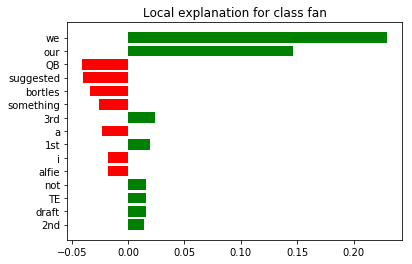

In [158]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [265]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('something', -0.008505558819131733),
 ('and', 0.002724158207251078),
 ('bortles', -0.002181994235544203),
 ('suggested', 0.0015123928977394878),
 ('dick', 0.0011049276809608592),
 ('day', 0.0009531144148283224),
 ('2nd', 0.0009355351430942052),
 ('draft', 0.0009042967311175791),
 ('3rd', 0.0008863256850122993),
 ('stupid', 0.0008202287706909236),
 ('don', 0.0007495801825418711),
 ('round', 0.0007327228828450986),
 ('shouldn', 0.0006882677507381932),
 ('good', 0.0006819282703668876),
 ('doesn', 0.00044646350097779915)]

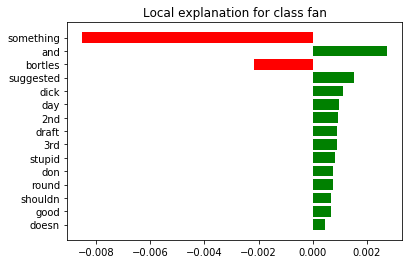

In [266]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [271]:
#test_case_comment = x_tokens[df.name]
#test_string = ' '.join(test_case_comment)
#test_string = ' '.join(token_list)
#list_strings = [test_string, test_string]
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

3rd         0.717636
.           0.583197
,           0.120446
"          -0.585650
football   -0.825541
dtype: float64

##### 2: LSTM is strong 'fan' and wrong

In [272]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] != lstm_pred_fan))]
df = df.loc[df['lstm_prob_fan'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                     55369
author_flair                                                                Panthers
submission_title                   Game Thread: New Orleans Saints (6-2) at Buffa...
comment_body                       Lol dude it was a joke. Of course I'm proud of...
fan_of_team_playing                                                                0
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    0
casual_prob_diff_lscn                                                      0.0523766
casual_prob_diff_lslg                                                       0.270633
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.136655
cnn_prob_diff                                                    

In [273]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [163]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.12109410220929483),
 ('our', 0.08429432467606329),
 ('frustrating', 0.018282098152755007),
 ('it', 0.013785790372787588),
 ('assistant', -0.008727040799118152),
 ('GM', 0.007533567703983362),
 ('fired', 0.007227000869223304),
 ('gigs', -0.007147125870953026),
 ('DC', -0.006220601200406744),
 ('OC', 0.006100049500057561),
 ('replaced', -0.006074026605379465),
 ('dude', -0.004578537869107996),
 ('i', 0.004260461209287466),
 ('competitive', -0.004232357044150031),
 ('losing', -0.0038270293182415148)]

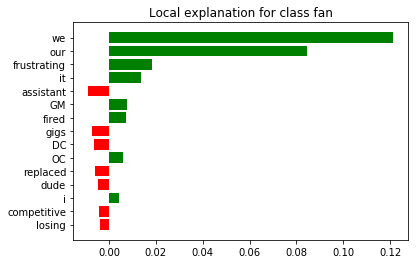

In [164]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [274]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('our', -0.005487304187120763),
 ('frustrating', -0.005372380944771228),
 ('GM', 0.0051058675248563815),
 ('because', -0.00471744377518907),
 ('dude', 0.0041221497364060805),
 ('we', -0.003080852033065444),
 ('competitive', -0.0025560878600325654),
 ('bad', 0.001818415317709316),
 ('and', 0.0015367243685558995),
 ('old', 0.0015322848454684438),
 ('hired', 0.0013128567805214503),
 ('proud', 0.0012387333123632404),
 ('fired', 0.001063654162233825),
 ('need', 0.0008479709646678912),
 ('replaced', 0.0006355929892510402)]

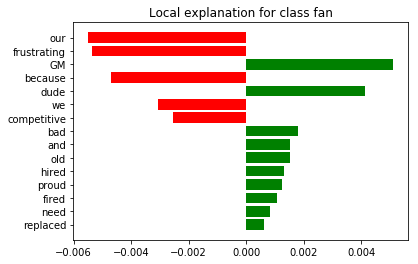

In [275]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [276]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

.      0.583197
lol   -0.098650
dtype: float64

##### 3: LSTM is weak 'fan' and right

In [277]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] == lstm_pred_fan) & \
                               (data_w_preds['fan_of_team_playing'] == 1))]
df = df.loc[df['lstm_prob_fan'].idxmin()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                   1476223
author_flair                                                                Seahawks
submission_title                   Game Thread: Seattle Seahawks (5-3) at Arizona...
comment_body                       Go look at the rule changes in the last 20+ ye...
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                      0.0902674
casual_prob_diff_lslg                                                      0.0404887
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.452242
cnn_prob_diff                                                    

In [278]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [169]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('the', -0.03404005973104576),
 ('teams', -0.025809159741684955),
 ('sorts', -0.02555942020573959),
 ('as', -0.02079921270597609),
 ('fuck', -0.019372276620212504),
 ('go', -0.018993254879537493),
 ('league', -0.018219003705240225),
 ('players', -0.01801402375153011),
 ('drives', 0.014936495033753081),
 ('defensive', 0.012333621701028825),
 ('s', 0.011474846847278342),
 ('it', 0.010376291628434725),
 ('special', 0.00989877046688598),
 ('decades', 0.006591155971886773),
 ('penalties', 0.006138334619660727)]

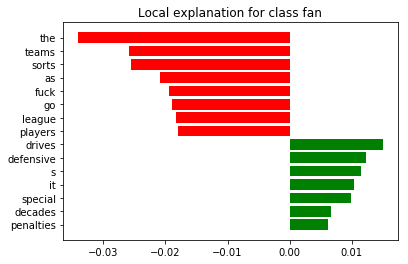

In [170]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [279]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('the', -0.004734261856075644),
 ('decades', 0.004600391689599481),
 ('interference', -0.003338212924660323),
 ('illegal', -0.0029614213611610044),
 ('DG', 0.0027954004733655507),
 ('unnecessary', -0.0027629881624691493),
 ('contact', -0.0025992696257614786),
 ('DGDG', 0.0025314581076084156),
 ('had', 0.0020437546093974254),
 ('days', 0.0006397526820808927),
 ('and', 0.0005540538794689632),
 ('would', 0.00045636842837758895),
 ('gawd', 0.00036827575553456297),
 ('today', 0.0003611779498000501),
 ('drives', 0.00022301493059790817)]

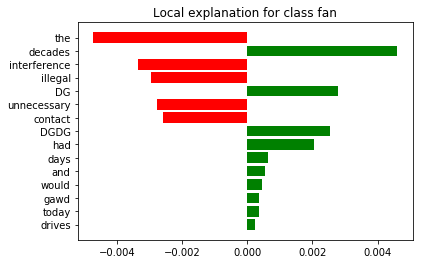

In [280]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [281]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

today        0.658215
fuck         0.645031
.            0.583197
holding      0.398694
refs         0.397465
DG           0.188517
,            0.120446
penalties    0.111688
dtype: float64

##### 4: LSTM is weak 'fan' and wrong

In [282]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] != lstm_pred_fan) & \
                               (data_w_preds['fan_of_team_playing'] == 0))]
df = df.loc[df['lstm_prob_fan'].idxmin()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                   1746207
author_flair                                                                Patriots
submission_title                   Game Thread: Baltimore Ravens (7-5) at Pittsbu...
comment_body                       A lot of people say that but the roster is get...
fan_of_team_playing                                                                0
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    0
casual_prob_diff_lscn                                                      0.0382627
casual_prob_diff_lslg                                                      0.0751678
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.400749
cnn_prob_diff                                                    

In [283]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [175]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('same', -0.1017600711098034),
 ('the', -0.06921080258273771),
 ('eagles', -0.049282349750893115),
 ('they', -0.043586288787667536),
 ('rookies', 0.042240543718426705),
 ('steelers', -0.036987139406082885),
 ('vikings', -0.03619235772275315),
 ('hightower', 0.03616143871580675),
 ('jacksonville', -0.03147403251791729),
 ('starters', 0.029367118290462266),
 ('and', -0.021963220858171328),
 ('point', -0.021678465915286823),
 ('favorites', -0.01834106550629387),
 ('offenses', 0.017257506756686893),
 ('lbs', 0.00974587488188862)]

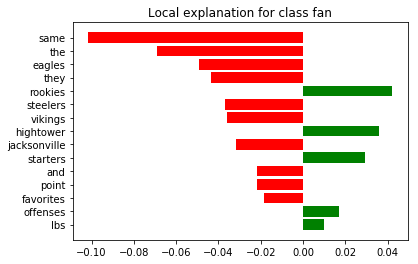

In [176]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [284]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('the', -0.0037907407604134283),
 ('and', 0.002579992339095241),
 ('keeps', -0.001993438419727692),
 ('they', -0.00192185971083944),
 ('DG', 0.0018879911573180502),
 ('waddle', 0.0013216256951738955),
 ('PG', 0.000288242112831149),
 ('hold', 0.00022754165123173276),
 ('edit', -0.00014901212671943832),
 ('bad', 0.00014627773827374302),
 ('2nd', 0.00013866950664089003),
 ('damn', 0.000122314188503517),
 ('faced', 8.42623437387031e-05),
 ('missed', -3.106500767308135e-05),
 ('good', -3.826151373904371e-06)]

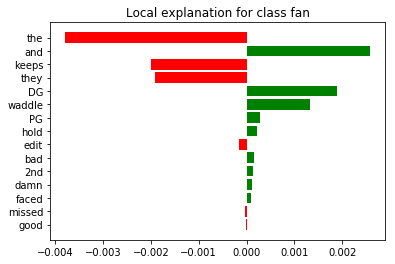

In [285]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [286]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

defense     1.276818
.           0.583197
hold        0.271391
injuries    0.149221
year        0.134699
,           0.120446
team        0.093540
:          -0.071707
steelers   -0.217327
eagles     -0.418548
dtype: float64

##### 5: LSTM is strong 'casual' and right

In [287]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]
df = df.loc[df['lstm_prob_casual'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                   1615072
author_flair                                                                no value
submission_title                   Game Thread: Los Angeles Chargers (0-0) at Den...
comment_body                       **Beth Mowins**\n\nBeth Mowins (born May 26, 1...
fan_of_team_playing                                                                0
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    0
casual_prob_diff_lscn                                                       0.016015
casual_prob_diff_lslg                                                       0.315994
cnn_pred_fan                                                                       0
cnn_prob_casual                                                             0.795668
cnn_prob_diff                                                    

In [288]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [182]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('DGDG', -0.038814333790222005),
 ('postedhyperlinkvalue', -0.004403034252535893),
 ('remove', -0.004085788916115148),
 ('sports', -0.0032145023006682435),
 ('mowins', -0.0029595515674626233),
 ('and', -0.0028911215125473557),
 ('to', -0.00281488843408957),
 ('ESPN', -0.0028083056968151968),
 ('FIFA', -0.0026881885739561515),
 ('DGDGDGDG', -0.002661227863184897),
 ('downvote', -0.002513956888967149),
 ('for', -0.002499170606299684),
 ('born', -0.0024526332000006715),
 ('televised', -0.0022727324576652655),
 ('v0', 0.001597496180765395)]

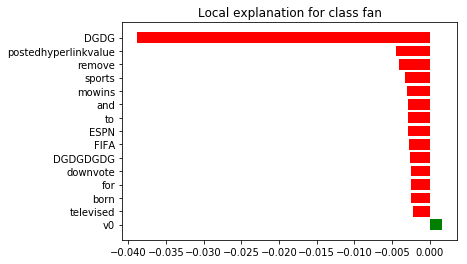

In [183]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [289]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('DGDGDGDG', 0.01688343803724259),
 ('DGDG', 0.00500513819835388),
 ('and', 0.0035601148740453735),
 ('college', -0.001935376684129547),
 ('subreddit', 0.001808831891143849),
 ('mowins', -0.001595512768983774),
 ('women', -0.00155204430888954),
 ('announcer', -0.0013726195373702033),
 ('exclude', 0.0012741667797808696),
 ('world', 0.0007938484405448888),
 ('paired', 0.0007783601545323548),
 ('broadcast', 0.00043260484168344143),
 ('second', 0.00032686358552551744),
 ('televised', 0.0001686773758903902),
 ('downvote', 0.00010189171998540692)]

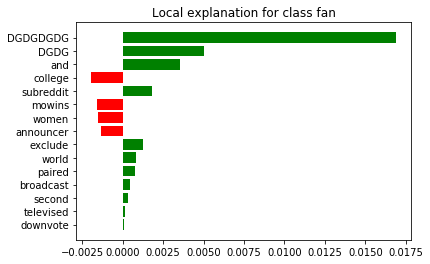

In [290]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [291]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

.           0.583197
calls       0.176740
,           0.120446
team        0.093540
^          -0.064442
*          -0.093824
football   -0.825541
dtype: float64

##### 6: LSTM is strong 'casual' and wrong

In [292]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] != lstm_pred_fan))]
df = df.loc[df['lstm_prob_casual'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                   1908324
author_flair                                                                 Packers
submission_title                   Game Thread: Green Bay Packers (6-6) at Clevel...
comment_body                       **Halfassed Halftime Adjustments for Success:*...
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                      0.0676032
casual_prob_diff_lslg                                                       0.294718
cnn_pred_fan                                                                       0
cnn_prob_casual                                                             0.709616
cnn_prob_diff                                                    

In [293]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [188]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('chris', -0.039319039541965306),
 ('playcalling', 0.02709936518550961),
 ('beef', -0.02301810162530847),
 ('drive', 0.01953761464318646),
 ('flavor', -0.014624939456891759),
 ('success', 0.013425148623727614),
 ('aaron', -0.013040308823572414),
 ('brady', -0.011666612959235321),
 ('hundley', -0.010356470710011348),
 ('spielman', -0.009945821302638574),
 ('jerky', -0.009525770585342926),
 ('kizer', -0.008448554399164504),
 ('josh', -0.007606672582882963),
 ('1st', 0.007060571368083712),
 ('adjustments', 0.006999977807542059)]

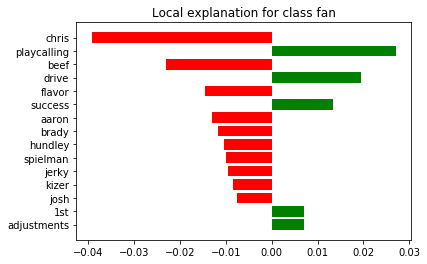

In [189]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [294]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('shredded', 0.004596393638945942),
 ('DGDG', 0.003475629651021888),
 ('the', -0.0029611727589272606),
 ('and', 0.0028777554215059236),
 ('DG', 0.0013033716551137354),
 ('brady', 0.0009066335524834897),
 ('parade', 0.0008914047244695175),
 ('ending', 0.0008090300196022538),
 ('gordon', 0.000796017274036799),
 ('hundley', 0.0007904207984210785),
 ('drive', 0.0007682039687670447),
 ('remind', 0.0007520556976900367),
 ('hide', 0.000726919849158475),
 ('halfassed', 0.0007214991586153085),
 ('needs', 0.0005496906997330703)]

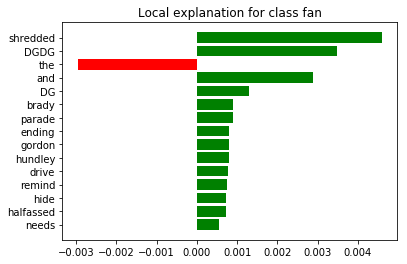

In [295]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [296]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

.         0.583197
drive     0.486823
run       0.433484
refs      0.397465
he's      0.224055
,         0.120446
:        -0.071707
*        -0.093824
game     -0.177843
browns   -0.229310
dtype: float64

##### 7: LSTM is weak 'casual' and right

In [297]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] == lstm_pred_fan) & \
                               (data_w_preds['fan_of_team_playing'] == 0))]
df = df.loc[df['lstm_prob_casual'].idxmin()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                   1343437
author_flair                                                                 Falcons
submission_title                   Game Thread: Dallas Cowboys (1-1) at Arizona C...
comment_body                       Meh the ratings have been dropping more or les...
fan_of_team_playing                                                                0
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    0
casual_prob_diff_lscn                                                      0.0489313
casual_prob_diff_lslg                                                      0.0140103
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.477946
cnn_prob_diff                                                    

In [298]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [194]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.10790084522846373),
 ('our', 0.07985776574307844),
 ('they', -0.056209118937556264),
 ('watch', -0.03774160224663313),
 ('unhealthy', -0.03580102303249469),
 ('dictate', -0.0332941099326643),
 ('a', -0.03231046498015311),
 ('platform', -0.030280854331035615),
 ('to', -0.026746643183084153),
 ('let', 0.026297073100826816),
 ('entertainment', 0.024469644101138412),
 ('americans', -0.02390161152584716),
 ('re', 0.020514226888256826),
 ('s', 0.016028992467996998),
 ('shit', 0.013149634325704606)]

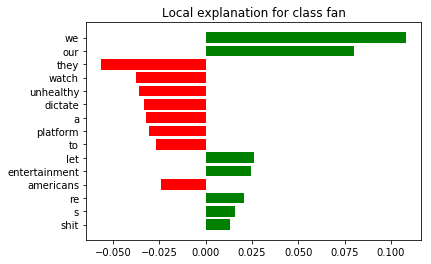

In [195]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [299]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('and', 0.005205940364861058),
 ('the', -0.0029614112011185816),
 ('they', -0.0024572000218379838),
 ('that', -0.0021185278678599612),
 ('have', -0.001877180424205672),
 ('to', -0.00171704952476848),
 ('add', 0.0007831719509134034),
 ('could', 0.0005074985987101132),
 ('addition', 0.0004896021457965091),
 ('damned', 0.00047792785128736705),
 ('thursday', 0.00031482316665110615),
 ('succeeded', 0.00030486376746368565),
 ('d', -0.0002063076252365845),
 ('do', -7.897230102349354e-05),
 ('declining', 7.327089694105625e-05)]

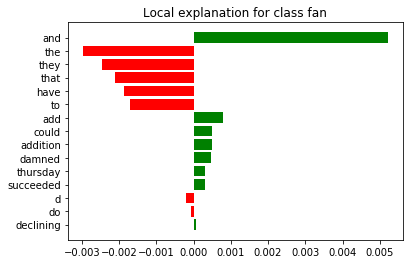

In [300]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [301]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

we're       2.364629
.           0.583197
!           0.306761
let's       0.161389
,           0.120446
just       -0.041905
thought    -0.091435
*          -0.093824
like       -0.282401
watch      -0.422499
football   -0.825541
NFL        -1.069938
dtype: float64

##### 8: LSTM is weak 'casual' and wrong

In [302]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((data_w_preds['fan_of_team_playing'] != lstm_pred_fan) & \
                               (data_w_preds['fan_of_team_playing'] == 1))]
df = df.loc[df['lstm_prob_casual'].idxmin()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                    803650
author_flair                                                                   Bears
submission_title                   Game Thread: Chicago Bears (5-10) at Minnesota...
comment_body                       stolen from a comment i wrote earlier:\n\nStil...
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                      0.0650622
casual_prob_diff_lslg                                                      0.0428304
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.485471
cnn_prob_diff                                                    

In [303]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [200]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('injuries', 0.028464033641787137),
 ('his', -0.028276201362379023),
 ('during', -0.027069881229218155),
 ('or', -0.023093335162511996),
 ('the', -0.015284530241600248),
 ('contract', 0.01486226621752017),
 ('path', -0.013899754654386356),
 ('future', -0.012947714488725734),
 ('is', -0.012794163300469452),
 ('projected', -0.012054837191659371),
 ('narrows', -0.011340864673648799),
 ('scheme', 0.010352835928397563),
 ('could', -0.010104421267996395),
 ('filled', -0.009806783545676677),
 ('raw', -0.009540803400384913)]

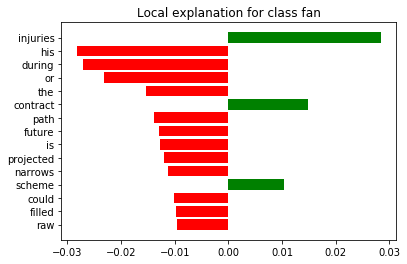

In [201]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [304]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('DGDG', 0.0032195343964977544),
 ('and', 0.0011999381114548575),
 ('could', 0.0011975735882187978),
 ('during', 0.0011954270618017876),
 ('the', -0.0011852186117197315),
 ('filled', 0.0011068601258853003),
 ('period', 0.0010497174108108514),
 ('league', -0.0010081799561913094),
 ('everything', -0.0009908986297447106),
 ('guessing', -0.0009799676908175787),
 ('experience', -0.0009727163668343771),
 ('his', -0.0009665879420619744),
 ('that', -0.0009329666918767318),
 ('projected', 0.0009324071735960701),
 ('more', -0.0009077092580006205)]

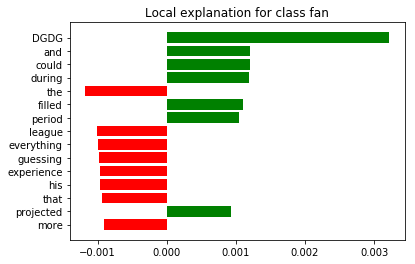

In [305]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [306]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

.           0.583197
half        0.462515
injuries    0.149221
year        0.134699
,           0.120446
just       -0.041905
:          -0.071707
game       -0.177843
"          -0.585650
dtype: float64

##### 9: LSTM and logistic disagree, LSTM is wrong,  and diff b/t LSTM and logistic prediction probs is as large as possible

In [307]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((lgst_pred_fan != lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] != lstm_pred_fan))]
df = df.loc[df['fan_prob_diff_lslg'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                    965655
author_flair                                                                Steelers
submission_title                   Game Thread: Kansas City Chiefs (0-0) at New E...
comment_body                                               Tonight we are all Chiefs
fan_of_team_playing                                                                0
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    0
casual_prob_diff_lscn                                                       0.177755
casual_prob_diff_lslg                                                       0.556635
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.369155
cnn_prob_diff                                                    

In [308]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [309]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.31741671062335225),
 ('chiefs', -0.022881312912156712),
 ('all', 0.022685635603724063),
 ('tonight', -0.013825526436817984),
 ('are', 0.0032165037095939057)]

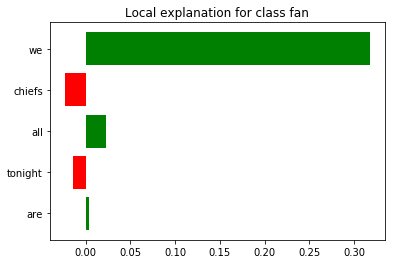

In [310]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [311]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('tonight', 0.0), ('we', 0.0), ('are', 0.0), ('all', 0.0), ('chiefs', 0.0)]

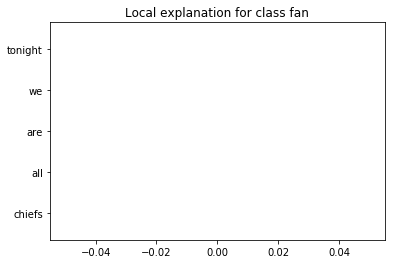

In [312]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [313]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

tonight   -0.439743
chiefs    -1.201071
dtype: float64

##### 10: LSTM and logistic disagree, LSTM is right,  and diff b/t LSTM and logistic prediction probs is as large as possible

In [314]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((lgst_pred_fan != lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]
df = df.loc[df['casual_prob_diff_lslg'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                    207694
author_flair                                                                Steelers
submission_title                   Game Thread: Pittsburgh Steelers (11-3) at Hou...
comment_body                       "We have to go back to the first quarter so we...
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                        0.13956
casual_prob_diff_lslg                                                       0.511735
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.305996
cnn_prob_diff                                                    

In [315]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.37376572397956587),
 ('commercial', -0.035153975764630446),
 ('first', 0.011236806702907706),
 ('quarter', 0.010265833866488914),
 ('have', 0.00728754559596459),
 ('another', 0.0038272928330936695),
 ('back', 0.0034826169142358364),
 ('so', 0.0027945666030653863),
 ('go', -0.0027403505641450045),
 ('can', -0.0025705210434501568),
 ('the', -0.002410152243382949),
 ('to', -0.00036163807166106115)]

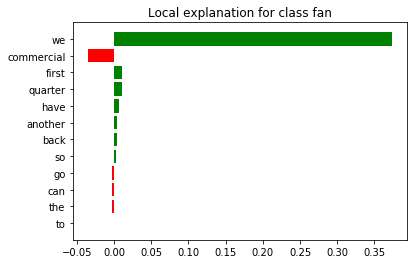

In [316]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [317]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('commercial', 0.0053584592977141245),
 ('have', 0.005302537751109252),
 ('another', 0.00493332581843257),
 ('quarter', 0.003778241812869144),
 ('we', 0.003610783772512823),
 ('to', 0.003060358942475867),
 ('the', 0.0027066147469440903),
 ('first', 0.0017866438284917722),
 ('can', 0.0014132279363155865),
 ('back', 0.0011927604423440758),
 ('so', 0.0011679043937938408),
 ('go', 0.0010803256101343994)]

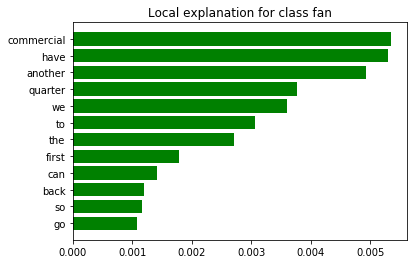

In [318]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [319]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

"            -0.585650
commercial   -0.836914
dtype: float64

##### 11: LSTM and logistic agree on fan and diff b/t LSTM and logistic prediction probs is as small as possible

In [320]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((lgst_pred_fan == lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == 1) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]
df = df.loc[df['fan_prob_diff_lslg'].idxmin()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                     47041
author_flair                                                                   49ers
submission_title                   Game Thread: Dallas Cowboys (2-3) at San Franc...
comment_body                                  Whoa that's crazy, how'd you spot that
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                       0.029773
casual_prob_diff_lslg                                                     0.00191974
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.448492
cnn_prob_diff                                                    

In [321]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('whoa', -0.044240090754963615),
 ('spot', 0.03688569492433735),
 ('crazy', -0.03605676231150188),
 ('s', 0.023315828328813563),
 ('d', 0.016857491072473498),
 ('that', 0.015440265635559362),
 ('how', 0.014864851740601231),
 ('you', 0.001227511980634853)]

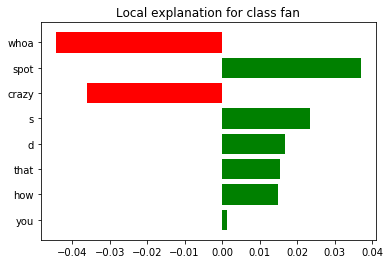

In [322]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [323]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('d', 0.018498450951510922),
 ('that', -0.005521141433832096),
 ('how', -0.00308885783129179),
 ('whoa', -0.002878927646269821),
 ('spot', -0.002258563707695572),
 ('you', -0.0019751162205999023),
 ('crazy', -0.0019027712016005055),
 ('s', -0.0002469551452354627)]

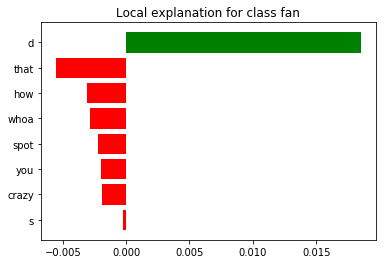

In [324]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [325]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

,    0.120446
dtype: float64

##### 12: LSTM and logistic agree on fan and diff b/t LSTM and logistic prediction probs is as large as possible

In [327]:
#np.where(lgst_pred_fan != lstm_pred_fan)
df = data_w_preds.iloc[1108289]
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
#df = data_w_preds.iloc[np.where((lgst_pred_fan == lstm_pred_fan) & \
#                                (data_w_preds['fan_of_team_playing'] == 1) & \
#                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]
#df = df.loc[df['fan_prob_diff_lslg'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                   1452205
author_flair                                                                 Vikings
submission_title                   Game Thread: Green Bay Packers (4-1) at Minnes...
comment_body                       Trae Waynes will never be a CB1. He just doesn...
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                      0.0254032
casual_prob_diff_lslg                                                        0.29622
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.196046
cnn_prob_diff                                                    

In [328]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))

In [224]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('waynes', 0.10727558177323683),
 ('CB1', 0.10583374872436659),
 ('trae', 0.08554768554298714),
 ('will', -0.024666398286914425),
 ('jordy', 0.022573748397864052),
 ('coverage', 0.02072947586679855),
 ('a', -0.01963569876420187),
 ('never', -0.01695989905767652),
 ('receivers', 0.014694623927935356),
 ('DGDG', -0.014555239402809386),
 ('deal', -0.014053590765543869),
 ('higher', -0.013745566120609284),
 ('general', -0.013220993105078144),
 ('his', -0.012633144674559126),
 ('be', 0.011284353830687453)]

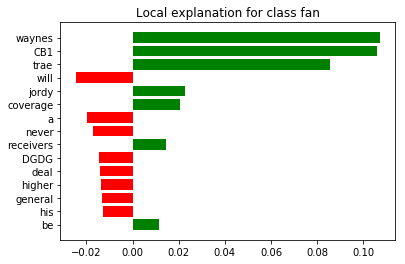

In [225]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [329]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('DGDG', 0.019372758173253048),
 ('receivers', -0.0039951173286613675),
 ('jordy', 0.0038166143056145557),
 ('deal', 0.0036126143874126372),
 ('doesn', 0.003308396011974933),
 ('coverage', -0.0031989209848644123),
 ('general', -0.0027883537919326695),
 ('never', -0.0027870725986554523),
 ('problems', -0.002564642222360885),
 ('higher', -0.00242705035176626),
 ('more', -0.002143988165787776),
 ('obviously', -0.0021316318561158372),
 ('the', -0.001762914466391646),
 ('trae', -0.0017502678923406363),
 ('have', -0.0016906326119096877)]

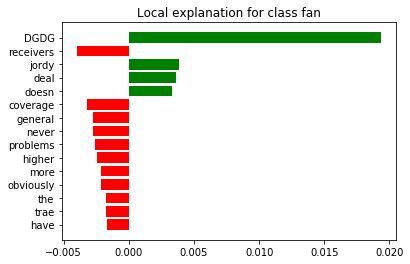

In [330]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [331]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

.       0.583197
just   -0.041905
dtype: float64

##### 13: LSTM and logistic agree on casual and diff b/t LSTM and logistic prediction probs is as large as possible

In [332]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((lgst_pred_fan == lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == 0) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]
df = df.loc[df['casual_prob_diff_lslg'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                    858313
author_flair                                                                no value
submission_title                   Game Thread: Green Bay Packers (1-0) at Atlant...
comment_body                       **Mercedes-Benz Stadium**\n\nMercedes-Benz Sta...
fan_of_team_playing                                                                0
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    0
casual_prob_diff_lscn                                                      0.0113906
casual_prob_diff_lslg                                                       0.310184
cnn_pred_fan                                                                       0
cnn_prob_casual                                                             0.799068
cnn_prob_diff                                                    

In [333]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('DGDG', -0.0414653351722015),
 ('v0', 0.005270209021358293),
 ('remove', -0.0019487778499085548),
 ('information', -0.0015338537592668778),
 ('source', -0.0011741722086451582),
 ('the', -0.0010847534443022655),
 ('MLS', -0.000864222557663958),
 ('stadium', -0.0007927388469385649),
 ('to', -0.0007721618840577484),
 ('retractable', -0.0007714321956239522),
 ('me', 0.000498285318499657),
 ('june', 0.0004217022442207746),
 ('adjacent', 0.0003163800536847902),
 ('organization', 0.0003101367261981932),
 ('benz', 0.00024942101763683654)]

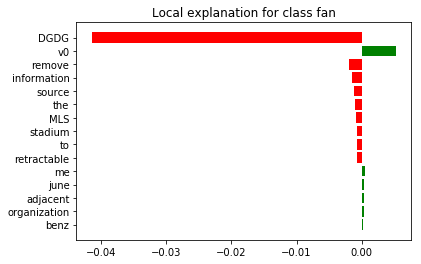

In [334]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [335]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('DGDGDGDG', 0.016437135832660054),
 ('stadium', 0.004263101568580789),
 ('the', -0.003881664154301857),
 ('and', 0.00252951517871946),
 ('georgia', -0.001973286768703358),
 ('falcons', -0.0017701301617698364),
 ('atlanta', -0.0016232093384286864),
 ('DG', 0.0015935223994749108),
 ('DGDG', 0.001582966945135031),
 ('benz', -0.0015129749668836593),
 ('league', -0.0013871595719719546),
 ('subreddit', 0.0012261056890117883),
 ('united', 0.000908441698790818),
 ('mercedes', 0.000857928661833584),
 ('exclude', 0.0007900698681548943)]

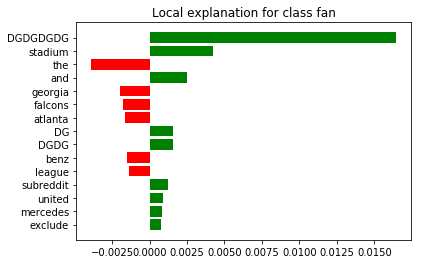

In [336]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [337]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

.           0.583197
,           0.120446
^          -0.064442
*          -0.093824
football   -0.825541
NFL        -1.069938
dtype: float64

##### 14: LSTM and logistic disagree and LSTM is strong 'fan' and wrong

In [338]:
#np.where(lgst_pred_fan != lstm_pred_fan)
#df = data_w_preds.iloc[np.where(lgst_pred_fan != lstm_pred_fan)]
df = data_w_preds.iloc[np.where((lgst_pred_fan != lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] != lstm_pred_fan))]
df = df.loc[df['lstm_prob_fan'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                    919550
author_flair                                                                   49ers
submission_title                   Game Thread: Seattle Seahawks (8-4) at Jackson...
comment_body                       Can we just skip our game against the Jags?  W...
fan_of_team_playing                                                                0
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    0
casual_prob_diff_lscn                                                      0.0850301
casual_prob_diff_lslg                                                       0.347004
cnn_pred_fan                                                                       1
cnn_prob_casual                                                             0.240882
cnn_prob_diff                                                    

In [339]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.18365339657275134),
 ('our', 0.12856082378041706),
 ('skip', -0.02503532557919358),
 ('jags', -0.022294182989397792),
 ('against', 0.011841967525742349),
 ('jimmy', -0.011631346177923703),
 ('just', 0.010556351491498238),
 ('IR', 0.009429330276693461),
 ('can', 0.008903728242886046),
 ('enough', 0.0063068917381229285),
 ('g', 0.005119858285722211),
 ('the', -0.004341445686864044),
 ('have', 0.004155340193287144),
 ('on', 0.004010802934279367),
 ('game', 0.0029167422196499444)]

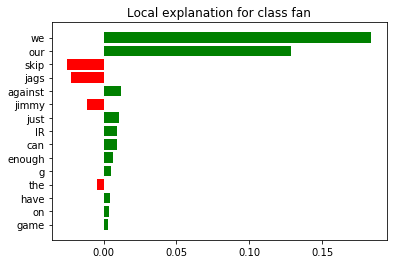

In [340]:
%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [341]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('and', 0.009209011473106049),
 ('need', 0.00791611391129872),
 ('we', -0.0024892644242530833),
 ('enough', -0.0019448155717342835),
 ('players', -0.0013125151477109524),
 ('game', -0.0011051377103362707),
 ('against', -0.001088563408548923),
 ('have', -0.0010104050122725049),
 ('alive', -0.0009031776279007885),
 ('the', -0.0008572751873675392),
 ('on', -0.0007020091984609247),
 ('jimmy', -0.0006906572733865697),
 ('just', -0.0006765083817249804),
 ('jags', -0.0006527788053769967),
 ('skip', -0.0004582085305456816)]

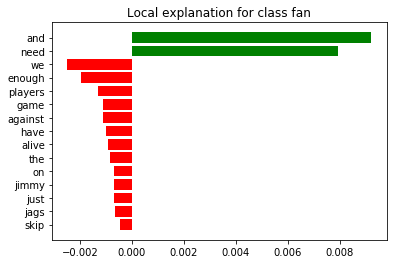

In [342]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [343]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

.       0.583197
just   -0.041905
jags   -0.173151
game   -0.177843
?      -0.318916
dtype: float64

##### 15. LSTM and logistic disagree and LSTM is strong 'fan' and right

In [344]:
#np.where(lgst_pred_fan != lstm_pred_fan)
df = data_w_preds.iloc[np.where((lgst_pred_fan != lstm_pred_fan) & \
                                (data_w_preds['fan_of_team_playing'] == lstm_pred_fan))]
df = df.loc[df['lstm_prob_fan'].idxmax()]
df
#Grab df.name to index all other unfiltered data structures!!!!!!!!

Unnamed: 0                                                                   1258957
author_flair                                                                 Raiders
submission_title                   Game Thread: New York Giants (2-9) at Oakland ...
comment_body                       And we fight and we drink  \nand we play and w...
fan_of_team_playing                                                                1
bandwagon                                                                          0
fan_of_team_playing_w_bandwagon                                                    1
casual_prob_diff_lscn                                                     0.00687605
casual_prob_diff_lslg                                                       0.358638
cnn_pred_fan                                                                       1
cnn_prob_casual                                                              0.16139
cnn_prob_diff                                                    

In [345]:
test_comment = comments[df.name]
token_list = x_tokens[df.name]
x_string = xtoken_to_raw(token_list)
num_features = min(15, len(token_list))
exp_lstm = explainer.explain_instance(x_string, predict_proba_string_lstm, num_features=num_features)
exp_lstm.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.37896855690686543),
 ('and', 0.023592174037001132),
 ('raiders', -0.023257036975249983),
 ('die', -0.007418757432267573),
 ('play', 0.006527008665801978),
 ('fight', -0.005414317710588541),
 ('till', 0.003573171687612663),
 ('lie', -0.002536807127741914),
 ('day', -0.0022101571765593916),
 ('drink', -0.002177566254068805),
 ('are', -0.0021177963622399805),
 ('the', -0.00045933814969030084),
 ('that', 0.0003830859479245803)]

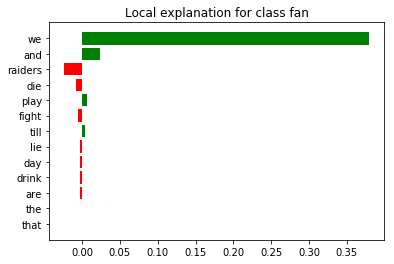

In [346]:

%matplotlib inline
fig = exp_lstm.as_pyplot_figure()
exp_lstm.show_in_notebook(text=True)

In [347]:
exp_lgst = explainer.explain_instance(x_string, c.predict_proba, num_features=num_features)
exp_lgst.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('and', 0.030907685584315298),
 ('we', -0.017736500547325257),
 ('day', 0.007232709413592568),
 ('the', -0.006741142178715648),
 ('die', 0.006134659350926987),
 ('drink', 0.005278010339094983),
 ('raiders', 0.0045192069809874245),
 ('lie', -0.002611657445036881),
 ('are', -0.002295844857199913),
 ('till', -0.0021241557933499217),
 ('that', -0.0020729872325529718),
 ('fight', -0.0018857384220690627),
 ('play', -0.0013340195241471212)]

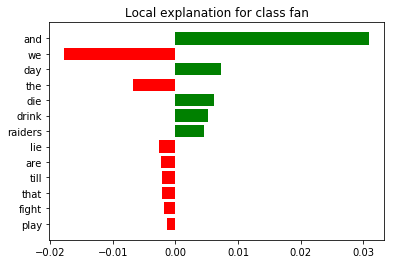

In [348]:
%matplotlib inline
fig = exp_lgst.as_pyplot_figure()
exp_lgst.show_in_notebook(text=True)

In [349]:
test_x_tokens = rawlist_to_xtokens([x_string], vocab=embeddings.wv.vocab)
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

play       0.113663
raiders   -0.495277
dtype: float64

###### Example output for analysis

In [243]:
test_case_comment = ['cvadsvgt', 'we', 'love', 'women', 'and', 'romo']
print(test_case_comment)
test_string = ' '.join(test_case_comment)
print(test_string)
list_strings = [test_string, test_string]
print(list_strings)
test_x_tokens = rawlist_to_xtokens([test_string, test_string], vocab=embeddings.wv.vocab)
print(test_x_tokens)

['cvadsvgt', 'we', 'love', 'women', 'and', 'romo']
cvadsvgt we love women and romo
['cvadsvgt we love women and romo', 'cvadsvgt we love women and romo']
[['we', 'love', 'women', 'and', 'romo'], ['we', 'love', 'women', 'and', 'romo']]


In [256]:
get_top_logreg_feats(feat_coefs=lgst_feat_coefs, xtokens=test_x_tokens)

we      3.880245
romo   -1.332523
dtype: float64

### Really interesting examples

In [940]:
#raw_string = xtoken_to_raw(x_tokens[4])
token_list = test_case_comment
raw_string = xtoken_to_raw(token_list) 
num_features = min(15, len(token_list))
#num_features = 10
exp = explainer.explain_instance(raw_string, predict_proba_string, num_features=num_features)
exp.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.30371463575512414),
 ('dance', -0.015042364708993693),
 ('can', 0.006120368086795557),
 ('to', -0.0015930683826819718),
 ('want', -0.0012870777512844307),
 ('if', 0.0009072080779275151)]

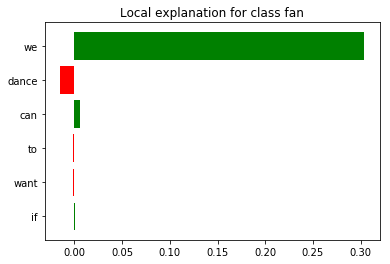

In [941]:
%matplotlib inline
fig = exp.as_pyplot_figure()

###### Identify Documents it predicted well and poorly

In [231]:
print(model.predict(padded_docs[4:5]))

[[0.17339884 0.82506466]]


In [312]:
type(model.predict(padded_docs[4:5]))

numpy.ndarray

In [313]:
model.predict(padded_docs[4:5]).shape

(1, 2)

In [234]:
pred_probs[4]

array([0.17339888, 0.82506454], dtype=float32)

In [683]:
print(prob_notfan[4])

0.17339888


In [686]:
print(type(prob_notfan))
print(prob_notfan.shape)

<class 'numpy.ndarray'>
(1542039,)


In [774]:
data_w_preds.tail()

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,fan_binary,prob_fan,prob_notfan,pred_fan,prob_off
1542034,2018023,Bengals,Game Thread: Cleveland Browns (2-0) at Tampa B...,Only when someone trash talks back. I don't go...,0,0,0,0,0.499014,0.501695,0,0.0
1542035,2018024,Buccaneers,Game Thread: Cleveland Browns (2-0) at Tampa B...,"the argument isn't for schedule, as we played ...",1,0,1,1,0.845279,0.200076,1,0.0
1542036,2018025,Patriots,Game Thread: Cleveland Browns (2-0) at Tampa B...,it would actually be 4-0-16 since they'd have ...,0,0,0,0,0.475391,0.526448,0,0.0
1542037,2018026,Browns,Game Thread: Cleveland Browns (2-0) at Tampa B...,"Another punt, another flag. Just saying.",1,0,1,1,0.572319,0.428385,1,0.0
1542038,2018027,Browns,Game Thread: Cleveland Browns (2-0) at Tampa B...,"So a guy held unnecessarily on a non return, h...",1,0,1,1,0.504840,0.496816,1,0.0


In [173]:
#test_case_comment = x_tokens[168787]
test_case_comment = ['cvadsvgt', 'hungry', 'cat', 'eats', 'dog']
print(test_case_comment)

['cvadsvgt', 'hungry', 'cat', 'eats', 'dog']


In [174]:
test_string = ' '.join(test_case_comment)
print(test_string)
list_strings = [test_string, test_string]
print(list_strings)
test_x_tokens = rawlist_to_xtokens([test_string, test_string], vocab=embeddings.wv.vocab)
print(test_x_tokens)

cvadsvgt hungry cat eats dog
['cvadsvgt hungry cat eats dog', 'cvadsvgt hungry cat eats dog']
[['hungry', 'cat', 'eats', 'dog'], ['hungry', 'cat', 'eats', 'dog']]


In [175]:
print(predict_proba_string(list_d_strings=list_strings, vocab=embeddings.wv.vocab, 
                           pad_func=pad_sequences, model=cnn))

[[0.4394923 0.5605077]
 [0.4394923 0.5605077]]


In [176]:
print(predict_proba_string(list_d_strings=list_strings, vocab=embeddings.wv.vocab, 
                           pad_func=pad_sequences, model=lstm))

[[0.42305458 0.57826984]
 [0.42305458 0.57826984]]


In [1014]:
class_names = ['casual observer', 'fan']

In [297]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=class_names)

In [335]:
#What are some examples of really likely "not fan" comments
sorted_idxs = np.argsort(pred_probs, axis=0)
#sorted_fan_idxs = np.argsort(sorted_idxs[:,1])
#sorted_notfan_idxs = np.argsort(sorted_idxs[:,0])
print(sorted_idxs)
print(sorted_idxs.shape)

[[ 184206 1249502]
 [1215462 1223482]
 [ 921828 1258841]
 ...
 [ 600678  243158]
 [ 310683  376111]
 [1218593   61192]]
(1542039, 2)


In [787]:
#Sort by how badly off the prediction is
sorted_bad_idxs = np.argsort(data_w_preds['prob_off'].values)
print(sorted_bad_idxs)
print(sorted_bad_idxs.shape)

[771019 900171 900173 ... 213943 233315 271820]
(1542039,)


In [861]:
#What are some examples of really bad predictions?
print("really bad predictions: ", sorted_bad_idxs[-5:])

really bad predictions:  [ 490740  857939 1538316  614442  554683]


In [842]:
data_bad_prednofan = data_w_preds[(data_w_preds['pred_fan'] == 0) & (data_w_preds['fan_of_team_playing_w_bandwagon'] == 1)]

In [862]:
data_bad_prednofan.sort_values('prob_off', ascending=False)[500:510]

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,fan_binary,prob_fan,prob_notfan,pred_fan,prob_off
392985,564039,Packers,Game Thread: Chicago Bears (1-2) at Green Bay ...,LOL Tony Romo is so pissed at the Bears rn,1,0,1,1,0.293939,0.707612,0,0.413673
796422,1103869,Giants,Game Thread: New York Giants (0-5) at Denver B...,You rang?\n\n*Ben McAdoo's cell phone has a ri...,1,0,1,1,0.293940,0.707606,0,0.413665
507161,719723,Vikings,Game Thread: Detroit Lions (2-1) at Minnesota ...,I think the NFL should clone Tony Romo so he c...,1,0,1,1,0.293941,0.707593,0,0.413651
1537860,2013767,Falcons,Game Thread: Atlanta Falcons (0-0) at Chicago ...,Atlanta Sports^^^^TM,1,0,1,1,0.293937,0.707541,0,0.413603
447609,619579,Redskins,Game Thread: New York Giants (2-8) at Washingt...,Apple commercials are like COD commercials in ...,1,0,1,1,0.294022,0.707584,0,0.413561
852122,1160324,Raiders,Game Thread: Oakland Raiders (0-0) at Tennesse...,Romo kinda sounds like Jon Gruden when he gets...,1,0,1,1,0.294016,0.707537,0,0.413520
1306524,1704086,Raiders,Game Thread: Seattle Seahawks (3-0) at Oakland...,These two are the WORST. And Beth just got a r...,1,0,1,1,0.294022,0.707509,0,0.413487
560484,773815,Eagles,Game Thread: Philadelphia Eagles (10-1) at Sea...,> I feel like Tony Romo should be doing the an...,1,0,1,1,0.294048,0.707485,0,0.413438
852368,1160574,Raiders,Game Thread: Oakland Raiders (0-0) at Tennesse...,Romo has a distinctive voice that's pleasant t...,1,0,1,1,0.294059,0.707484,0,0.413425
29326,70229,Packers,Game Thread: Green Bay Packers (5-5) at Pittsb...,"""What's a computer?"" Give me a fucking break w...",1,0,1,1,0.294107,0.707414,0,0.413307


In [938]:
test_case_idx = 490740
data_w_preds.iloc[[test_case_idx]]

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,fan_binary,prob_fan,prob_notfan,pred_fan,prob_off
490740,703055,Lions,Game Thread: Indianapolis Colts (1-2) at Seatt...,We can dance if we want to..........,0,0,0,0,0.834386,0.164192,1,0.670193


In [939]:
test_case_comment = x_tokens[test_case_idx]
print(pred_probs[test_case_idx])
print(test_case_comment)

# poor prediction examples: 
#(pred: fan, act: not fan) - *60175* *213943* *490740*
#(pred: not fan, act: fan) - *664192* **116018** **1306524**

[0.1641925 0.834386 ]
['we', 'can', 'dance', 'if', 'we', 'want', 'to', '.']


In [940]:
#raw_string = xtoken_to_raw(x_tokens[4])
token_list = test_case_comment
raw_string = xtoken_to_raw(token_list) 
num_features = min(15, len(token_list))
#num_features = 10
exp = explainer.explain_instance(raw_string, predict_proba_string, num_features=num_features)
exp.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.30371463575512414),
 ('dance', -0.015042364708993693),
 ('can', 0.006120368086795557),
 ('to', -0.0015930683826819718),
 ('want', -0.0012870777512844307),
 ('if', 0.0009072080779275151)]

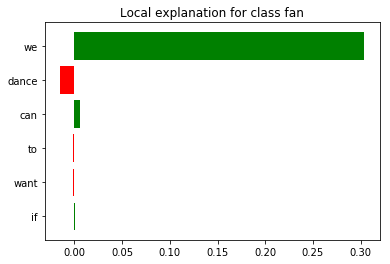

In [941]:
%matplotlib inline
fig = exp.as_pyplot_figure()

In [943]:
exp.show_in_notebook(text=True)

In [714]:
#print(sorted_idxs[:,1].shape)
#sorted_fan_idxs = np.argsort(sorted_idxs[:,1], axis=0)
print("top fan comments: ", sorted_idxs[:,1][-500:-495])

top fan comments:  [ 911088 1156310  776127   60175  643946]


In [931]:
test_case_idx = 243158
data_w_preds.iloc[[test_case_idx]]

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,fan_binary,prob_fan,prob_notfan,pred_fan,prob_off
243158,359316,Colts,Game Thread: Pittsburgh Steelers (6-2) at Indi...,Don't worry guys. We are the WORST second half...,1,0,1,1,0.851924,0.192462,1,0.0


In [902]:
test_case_comment = x_tokens[test_case_idx]
print(pred_probs[test_case_idx])
print(test_case_comment)

# keeper fan examples: 168787 506716 *243158* *376111* 776127

[0.5004545 0.5008337]
['oh', '.', 'shit', 'i', 'forgot', 'i', "can't", 'run', 'into', 'this', 'dude', '.', 'better', 'wait', 'till', 'the', 'last', 'second', 'to', 'adjust', '.']


In [879]:
#raw_string = xtoken_to_raw(x_tokens[4])
token_list = test_case_comment
raw_string = xtoken_to_raw(token_list) 
num_features = min(15, len(token_list))
#num_features = 10
exp = explainer.explain_instance(raw_string, predict_proba_string, num_features=num_features)
exp.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('we', 0.21289699984243432),
 ('ourselves', 0.06398914543324989),
 ('pats', -0.04469728958567312),
 ('held', 0.020864129228431876),
 ('weren', 0.010730128942090677),
 ('fuck', 0.010678983379524734),
 ('actually', -0.010158429739291116),
 ('ways', 0.008648835962446715),
 ('t', 0.007461993299672761),
 ('to', -0.0066494519318414476),
 ('league', -0.006612001270094995),
 ('could', -0.004804284495271673),
 ('FG', 0.004796868531699969),
 ('if', 0.00472772263501194),
 ('them', 0.004248897590602342)]

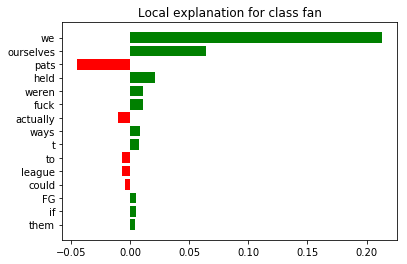

In [880]:
%matplotlib inline
fig = exp.as_pyplot_figure()

In [881]:
exp.show_in_notebook(text=True)

In [793]:
#print(sorted_idxs[:,1].shape)
#sorted_fan_idxs = np.argsort(sorted_idxs[:,1], axis=0)
print("top not fan comments: ", sorted_idxs[:,0][-200:-195])

top not fan comments:  [ 392287 1209825  168729 1335282  550209]


In [935]:
test_case_idx = 
data_w_preds.iloc[[test_case_idx]]

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,fan_binary,prob_fan,prob_notfan,pred_fan,prob_off
1209825,1606151,Giants,Game Thread: Los Angeles Chargers (0-0) at Den...,Is it possible that ESPN intentionally paired ...,0,0,0,0,0.278956,0.722679,0,0.0


In [936]:
test_case_comment = x_tokens[test_case_idx]
print(pred_probs[test_case_idx])
print(test_case_comment)

# keeper not fan examples: *1318059* 1466356 363032 *863651* 116018 685646 569303 *848833* *1209825* *1335282*
# *1223239* *1204415*

[0.722679  0.2789563]
['is', 'it', 'possible', 'that', 'ESPN', 'intentionally', 'paired', 'ryan', 'with', 'mowers', 'to', 'deflect', 'criticism', 'from', 'her', '?', 'hear', 'me', 'out', 'on', 'this', '.', 'there', 'will', 'be', 'a', 'lot', 'of', 'bullshit', 'out', 'there', 'about', 'these', 'GAW', 'DAMN', 'WOMENFOLK', 'ON', 'THE', 'TEEVEE', 'DURIN', 'FOOTBAW', 'GAMES', 'and', 'even', 'though', 'she', 'has', 'an', 'irritating', 'voice', 'and', 'is', 'an', 'average', 'at', 'best', 'commentator', ',', "she's", 'miles', 'ahead', 'of', 'ryan', '.', 'is', 'it', 'inconceivable', 'that', 'they', 'stuck', 'a', 'complete', 'buffoon', 'with', 'her', 'so', 'she', 'looks', 'better', 'by', 'contrast', '?', 'or', 'is', 'ESPN', 'really', 'just', 'scraping', 'the', 'bottom', 'of', 'the', 'barrel', 'here', '?']


In [885]:
#raw_string = xtoken_to_raw(x_tokens[4])
token_list = test_case_comment
raw_string = xtoken_to_raw(token_list) 
num_features = min(15, len(token_list))
#num_features = 10
exp = explainer.explain_instance(raw_string, predict_proba_string, num_features=num_features)
exp.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('treasure', -0.02221898509735328),
 ('indian', -0.010506895363057378),
 ('economy', -0.00911684744761165),
 ('programs', -0.00907690826248495),
 ('the', -0.00869958413531104),
 ('england', -0.008553945752282273),
 ('activity', -0.008420913870346419),
 ('emperor', -0.007399719123898209),
 ('naval', -0.00719893838926793),
 ('world', -0.006690294084471674),
 ('hongxi', -0.0059866942226489955),
 ('china', -0.00572500159910974),
 ('all', 0.0030346574578591226),
 ('and', 0.0029138414517742737),
 ('burn', 0.0026010261592470875)]

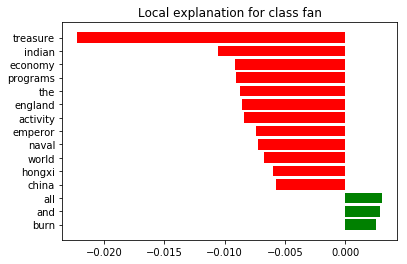

In [886]:
%matplotlib inline
fig = exp.as_pyplot_figure()

In [887]:
exp.show_in_notebook(text=True)

In [566]:
#print(sorted_idxs[:,1].shape)
#sorted_fan_idxs = np.argsort(sorted_idxs[:,1], axis=0)
print("Ambiguous comments: ", sorted_idxs[:,1][-874085:-874080])

Ambiguous comments:  [1004823  707635 1446442  630466  872419]


In [903]:
test_case_idx = 1306524
data_w_preds.iloc[[test_case_idx]]

,Unnamed: 0,author_flair,submission_title,comment_body,fan_of_team_playing,bandwagon,fan_of_team_playing_w_bandwagon,fan_binary,prob_fan,prob_notfan,pred_fan,prob_off
1306524,1704086,Raiders,Game Thread: Seattle Seahawks (3-0) at Oakland...,These two are the WORST. And Beth just got a r...,1,0,1,1,0.294022,0.707509,0,0.413487


In [904]:
test_case_comment = x_tokens[test_case_idx]
print(pred_probs[test_case_idx])
print(test_case_comment)

# keeper ambiguous examples: 701010 1006511 1488004 1004673 943226 1145143 **1385938** (1119059) *365951* 1004823

[0.7075086 0.2940219]
['these', 'two', 'are', 'the', 'WORST', '.', 'and', 'beth', 'just', 'got', 'a', 'real', 'commentator', 'job', ',', 'DG', 'monday', 'night', 'game', 'i', 'think', ',', 'so', 'that', 'tells', 'you', 'she', 'only', 'got', 'it', 'because', "she's", 'a', 'woman', ',', 'because', 'this', 'is', 'the', 'world', 'we', 'live', 'in', 'now', '.']


In [906]:
#raw_string = xtoken_to_raw(x_tokens[4])
token_list = test_case_comment
raw_string = xtoken_to_raw(token_list) 
num_features = min(15, len(token_list))
#num_features = 10
exp = explainer.explain_instance(raw_string, predict_proba_string, num_features=num_features)
exp.as_list()

/Users/chadharness/anaconda/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


[('she', -0.061966370914768025),
 ('beth', -0.06016265147830271),
 ('we', 0.05620953911091679),
 ('monday', -0.039495892055362754),
 ('commentator', -0.028439005772369238),
 ('night', -0.023507336287073383),
 ('woman', -0.019580789102553443),
 ('now', 0.018789162268245795),
 ('s', -0.01591245975422062),
 ('live', -0.015885881177253817),
 ('world', -0.01007351393387682),
 ('game', -0.008309471270073239),
 ('these', -0.007563401481697167),
 ('in', -0.007503683155779712),
 ('tells', -0.005740244872791881)]

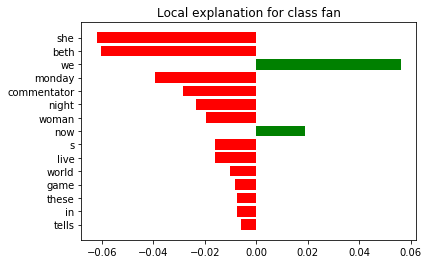

In [907]:
%matplotlib inline
fig = exp.as_pyplot_figure()

In [908]:
exp.show_in_notebook(text=True)

In [677]:
# Save the predictions alongside the comments in a dataframe
docs = data['comment_body'].values
model_preds = pd.DataFrame(index=docs)
model_preds['predicted_class'] = 0
model_preds['predicted_class'] = predict_prob
# Predicted class is actually the inverse (I think)
model_preds['predicted_class'] = 1 - model_preds['predicted_class']
model_preds['actual_class'] = labels
model_preds['prob_off'] = abs(model_preds['predicted_class'] - model_preds['actual_class'])

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1b45537518>,
      dtype=object)

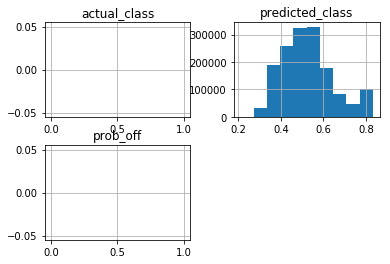

In [678]:
# Plot to see the distribution of the errors
model_preds.hist()

In [679]:
# Example of a well predicted comment of a non-fan
print('-------------------------')
print('----predicted as: {}'.format(model_preds.sort_values('prob_off')['predicted_class'][0]))
print('----actually: {}---(1 = fan, 0 = not fan --------'.format(model_preds.sort_values('prob_off')['actual_class'][0]))
print('-------comment-----------')
print(model_preds.sort_values('prob_off').index[0])

-------------------------
----predicted as: 0.4310060739517212
----actually: nan---(1 = fan, 0 = not fan --------
-------comment-----------
I love Lions fans cause we can drink bleach together this christmas eve


In [676]:
# Example of a well predicted comment of a fan
print('-------------------------')
print('----predicted as: {}'.format(model_preds.loc[model_preds['actual_class'] == 1].sort_values('prob_off')['predicted_class'][2]))
print('----actually: {}---(1 = fan, 0 = not fan --------'.format(model_preds.loc[model_preds['actual_class'] == 1].sort_values('prob_off')['actual_class'][2]))
print('-------comment-----------')
print(model_preds.loc[model_preds['actual_class'] == 1].sort_values('prob_off').index[2])

-------------------------


IndexError: index out of bounds

In [211]:
# Example of a poorly predicted comment of a non-fan
print('-------------------------')
print('----predicted as: {}'.format(model_preds.sort_values('prob_off')['predicted_class'][-1]))
print('----actually: {}---(1 = fan, 0 = not fan --------'.format(model_preds.sort_values('prob_off')['actual_class'][-1]))
print('-------comment-----------')
print(model_preds.sort_values('prob_off').index[-1])

-------------------------
----predicted as: 0.0809553861618042
----actually: 1---(1 = fan, 0 = not fan --------
-------comment-----------
What...what do you mean?  

Edit:  I'll attempt to answer.

> *How* is New England the 1 seed in the AFC?

New England is the 1 seed because they beat the Pittsburgh Steelers to take first seed, due to tiebreaker going to the Pats due to the win.  

> How is *New England* the 1 seed in the AFC?

They went 4-2 in their first 6 games of the season, arguably the hardest games on the schedule.  They finish off the season with mostly divisional matchups, for which they are currently 4-1 in.  

> How is New England the *1* seed in the AFC?

Tiebreaker over Pittsburgh.  

> How is New England the 1 seed in the *AFC*?

The Patriots play in the AFC.  


In [217]:
# Example of a poorly predicted comment of a fan
print('-------------------------')
print('----predicted as: {}'.format(model_preds.sort_values('prob_off')['predicted_class'][-10]))
print('----actually: {}---(1 = fan, 0 = not fan --------'.format(model_preds.sort_values('prob_off')['actual_class'][-10]))
print('-------comment-----------')
print(model_preds.sort_values('prob_off').index[-10])

-------------------------
----predicted as: 0.0934571623802185
----actually: 1---(1 = fan, 0 = not fan --------
-------comment-----------
In the lead-up to the eclipse, I read a lot about the damage you could do to your eyes by looking at it without the proper protective glasses on. They said optomotrists would be able to tell you looked at the sun, because the outline of the eclipse would be burned into the cornea. For the rest of your life, that image is literally burned into your eye. It never goes away. It never heals. The damage is permanent.

If you look into my eyes, you can see the outline of the David Tyree helmet catch. It never goes away. It never heals. The damage is permanent.

I wish you the best this season, my friend.


In [233]:
# Example of a poorly predicted comment of a non-fan
# They actually sound like a fan - probably mislabeled
print('-------------------------')
print('----predicted as: {}'.format(model_preds.sort_values('prob_off')['predicted_class'][-21]))
print('----actually: {}---(1 = fan, 0 = not fan --------'.format(model_preds.sort_values('prob_off')['actual_class'][-21]))
print('-------comment-----------')
print(model_preds.sort_values('prob_off').index[-21])

-------------------------
----predicted as: 0.8980789184570312
----actually: 0---(1 = fan, 0 = not fan --------
-------comment-----------
the biggest problem is injuries and in a close second our pass blocking. if we were healthy and our pass blocking was competent our pass heavy offense would work but eli has had 2 seconds to throw the ball and has made bad throws with players wide open. you can definitely say our defense has still been good regardless of the shit show our offense has been and that is without our best coverage LB and last game without our MLB and Jackrabbit.  


In [237]:
# Example of a poorly predicted comment of a non-fan
# They actually sound like a fan too! Probably mislabeled
print('-------------------------')
print('----predicted as: {}'.format(model_preds.sort_values('prob_off')['predicted_class'][-29]))
print('----actually: {}---(1 = fan, 0 = not fan --------'.format(model_preds.sort_values('prob_off')['actual_class'][-29]))
print('-------comment-----------')
print(model_preds.sort_values('prob_off').index[-29])

-------------------------
----predicted as: 0.8941841125488281
----actually: 0---(1 = fan, 0 = not fan --------
-------comment-----------
There defense has only allowed one team to score 20 points and in the 4th quarter the offense tends to get their head out of their asses. Our offense is 32nd in the league and the defense has the ability to be top 10. Our oline is killing us. Our LT is hurt and we are missing both of our starting guards. It's bad


# Use the model to predict some test cases

In [243]:
tests = ['we are awesome',
         'our team is awesome',
         'jags suck',
         'when will we win',
         'we are so dumb',
         'they suck',
         'why arent we winning',
        'this is hilarious',
        'just tuned in',
        'rigged refs',
        'i hate football',
        'i love football',
        'that was a horrible call',
        'we are so good',
        'they',
        'we',
        'tom brady is so good that they dont know what to do with him',
        'I love Lions fans cause we can drink bleach together this christmas eve']
encoded_test = [one_hot(str(d), vocab_size) for d in tests]
padded_test = pad_sequences(encoded_test, maxlen=max_length, padding='post')
preds_test = model.predict(padded_test)

In [244]:
test_results = pd.DataFrame(index=tests)
test_results['prediction'] = 0
test_results['prediction'] = preds_test
# Predicted class is actually the inverse (I think)
test_results['prediction'] = 1 - test_results['prediction']
test_results

,prediction
we are awesome,0.647458
our team is awesome,0.767350
jags suck,0.232012
when will we win,0.749833
we are so dumb,0.714126
they suck,0.451200
why arent we winning,0.752060
this is hilarious,0.378172
just tuned in,0.209693
rigged refs,0.468423
